In [1]:
import scvelo as scv
import numpy as np
import pandas as pd
import scanpy as sc
import loompy
import matplotlib as mpl
import matplotlib.pyplot as pl

import collections.abc
#cellrank needs the following alias to be done manually.
collections.Iterable = collections.abc.Iterable
import cellrank as cr
from scipy.stats import mode
from collections import Counter
from matplotlib import rcParams
#import diffxpy as de
#import palantir
import seaborn
import warnings
import scanpy.external as sce


In [2]:
#settings
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.set_figure_params(color_map='viridis')
sc.settings.set_figure_params(dpi=80, facecolor='white')
scv.settings.presenter_view = True  # set max width size for presenter view
scv.set_figure_params('scvelo')  # for beautified visualization

scanpy==1.9.3 anndata==0.9.1 umap==0.5.3 numpy==1.23.5 scipy==1.10.1 pandas==2.0.1 scikit-learn==1.2.2 statsmodels==0.14.0 python-igraph==0.10.4 pynndescent==0.5.10


In [3]:
#results file
results_file = 'C:/Users/rvi33352/Documents/Sox2TdT_C18A2CE/ScVelo/scanpy/JupyterCocktail_Scanpy.h5ad'  # the file that will store the analysis results

In [4]:
#read h5 OR h5ac
adata = sc.read_10x_h5(filename = 'C:/Users/rvi33352/Documents/Sox2TdT_C18A2CE/cocktail/Cocktail_filtered_feature_bc_matrix.h5')
#adata = sc.read_h5ad(filename = '/Users/renevielman/OneDrive - Creighton University/Creighton/scRNAseq/Scanpy/Conversion.h5ad')
adata

reading C:/Users/rvi33352/Documents/Sox2TdT_C18A2CE/cocktail/Cocktail_filtered_feature_bc_matrix.h5
 (0:00:00)


C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\anndata\_core\anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\anndata\_core\anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 14849 × 32287
    var: 'gene_ids', 'feature_types', 'genome'

In [5]:
adata.var_names_make_unique()

normalizing counts per cell
    finished (0:00:00)


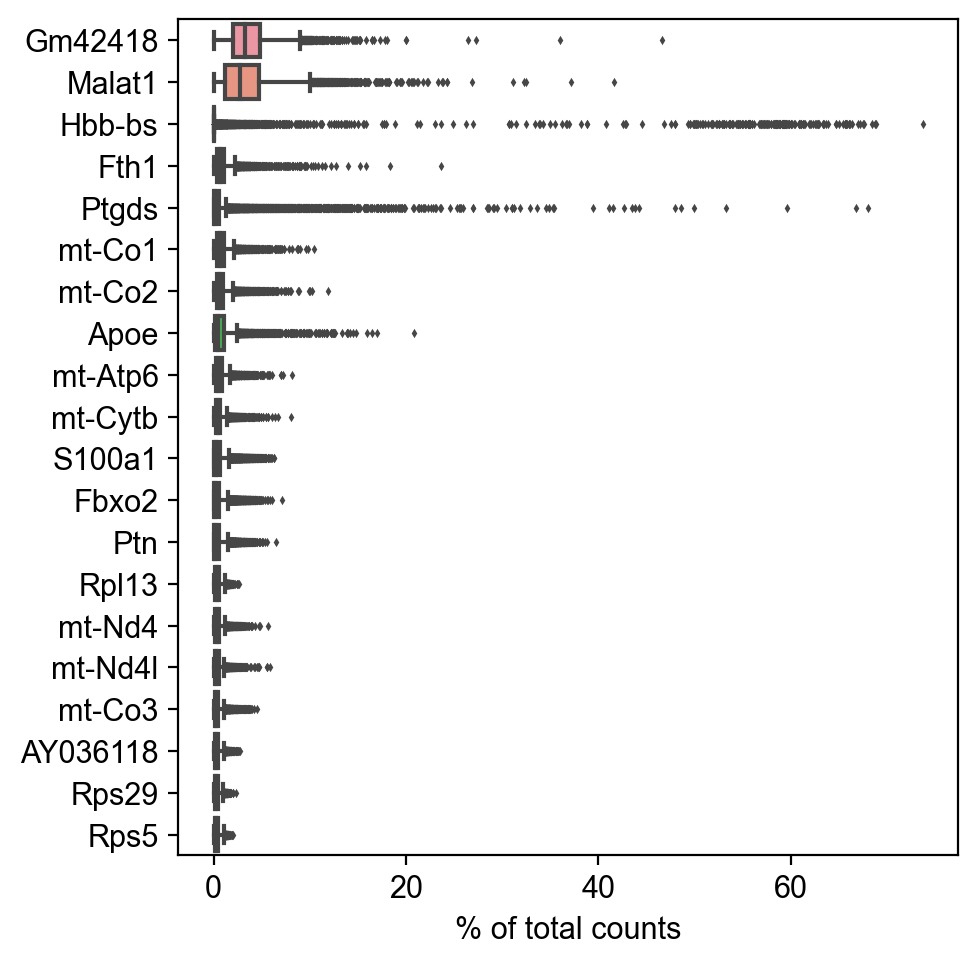

In [6]:
#highest expressed genes
sc.pl.highest_expr_genes(adata, n_top=20, )

filtered out 179 cells that have less than 200 genes expressed
filtered out 12105 genes that are detected in less than 3 cells


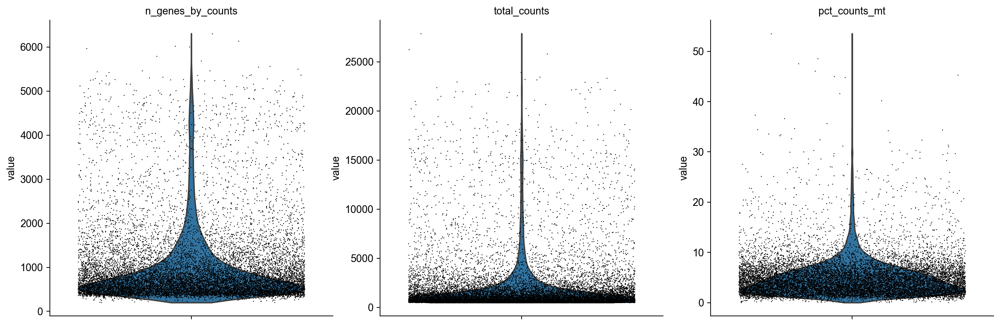

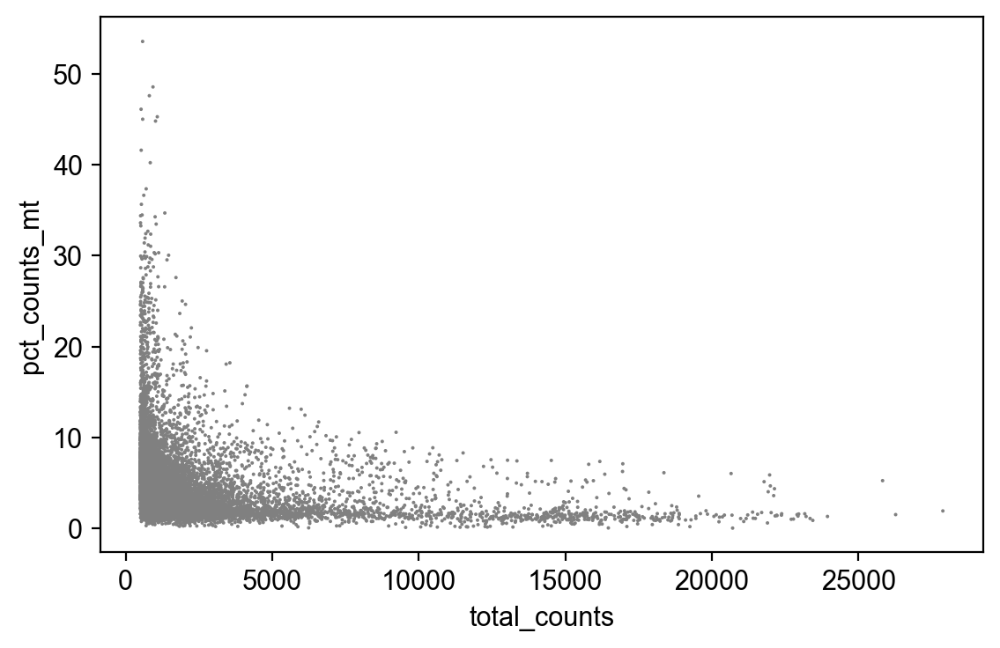

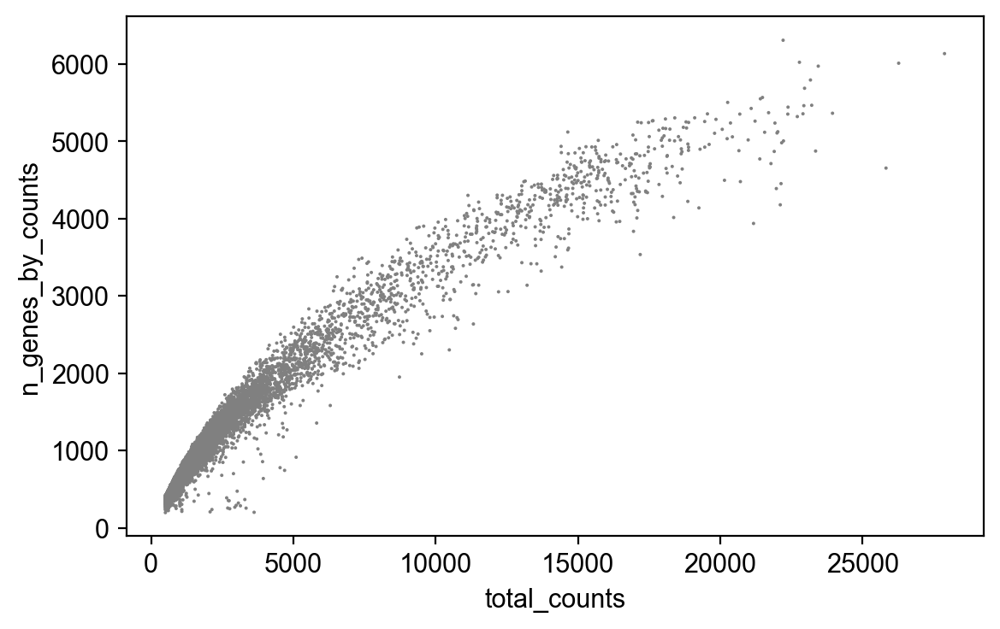

normalizing counts per cell
    finished (0:00:00)


C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\preprocessing\_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [7]:
#filtering and normalization
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)
adata.var['mt'] = adata.var_names.str.startswith('mt-')
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')
adata = adata[adata.obs.n_genes_by_counts < 2500, :]
adata = adata[adata.obs.pct_counts_mt < 10, :]
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

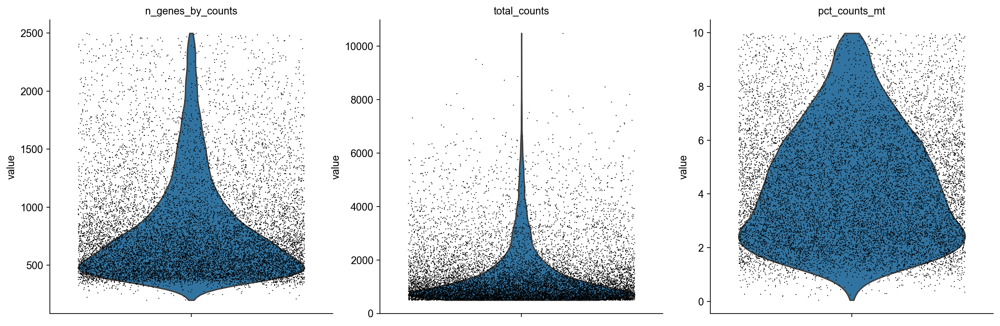

In [8]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


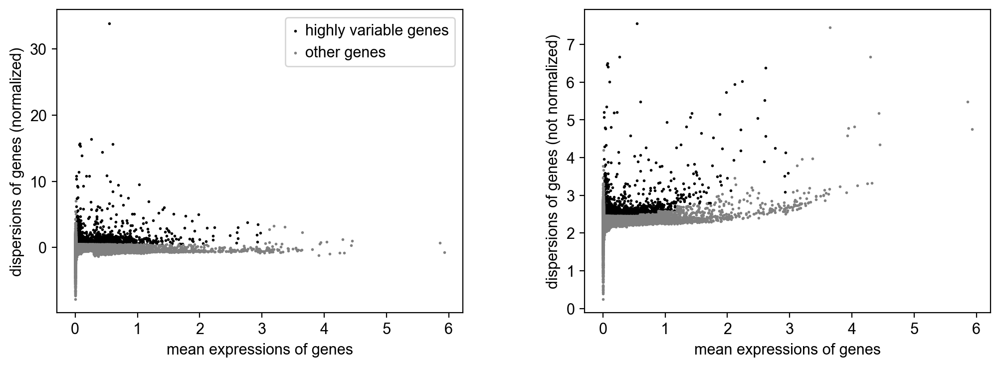

In [9]:
#identify highly variable genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)

In [10]:
adata

AnnData object with n_obs × n_vars = 12815 × 20182
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

In [11]:
#set raw data
adata.raw = adata

In [12]:
#filtering, regression and scaling
adata = adata[:, adata.var.highly_variable]

In [13]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:22)


In [14]:
sc.pp.scale(adata, max_value=10)

In [15]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20)

computing neighbors
         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:00:03)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:22)


In [16]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)


computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


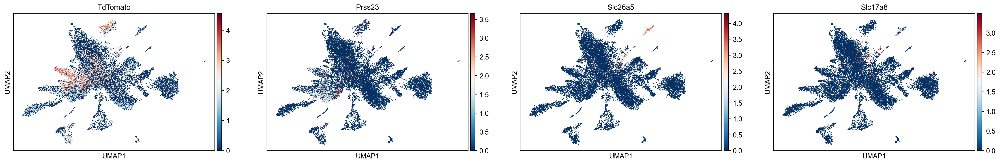

In [17]:
sc.tl.umap(adata) 
sc.pl.umap(adata, color=['TdTomato', 'Prss23', 'Slc26a5', 'Slc17a8']) 

In [18]:
sc.tl.leiden(adata)

running Leiden clustering
    finished: found 22 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


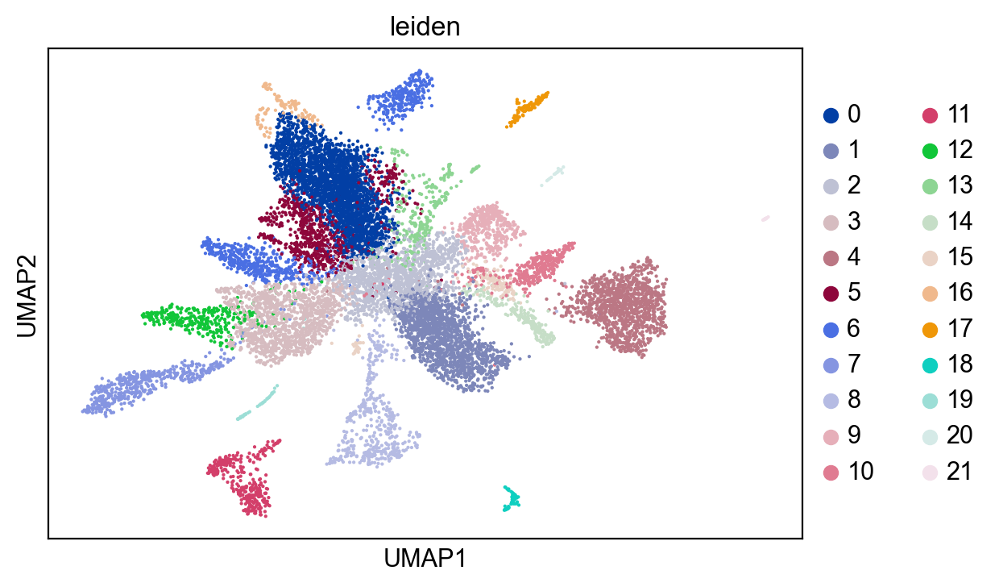

In [19]:
sc.pl.umap(adata, color = 'leiden')

In [20]:
marker_genes = ["TdTomato", "Sox2", "Sox9", "Sox10", "Lfng", "Cdkn1b", "Gjb2", "Prss23", "S100a6", 
                "S100a1", "Slc1a3", "Fst", "Fabp7", "Fgfr3", "Lgr5", "Gata3", "Spry2", "Myo6", 
                "Myo7a", "Slc26a5", "Slc17a8", "Otof", "Ocm", "Pvalb", "Calb2", "Ikzf2",
               "Tbx2", "Pou4f3", "Pcp4", "Espn", "Isl1", "Nefh", "Thy1", "Tubb3", "Cldn11", 
               "Met", "Dct", "Coch", "Emilin2", "Kcnq1", "Cx3cr1", "Cd3g", "Cd4", "Mpz", 
                  "Mbp", "Plp1", "Slc26a4", "Vmo1", "Itgam", "Cd79a", "Hba-a1", "Hba-a2"]

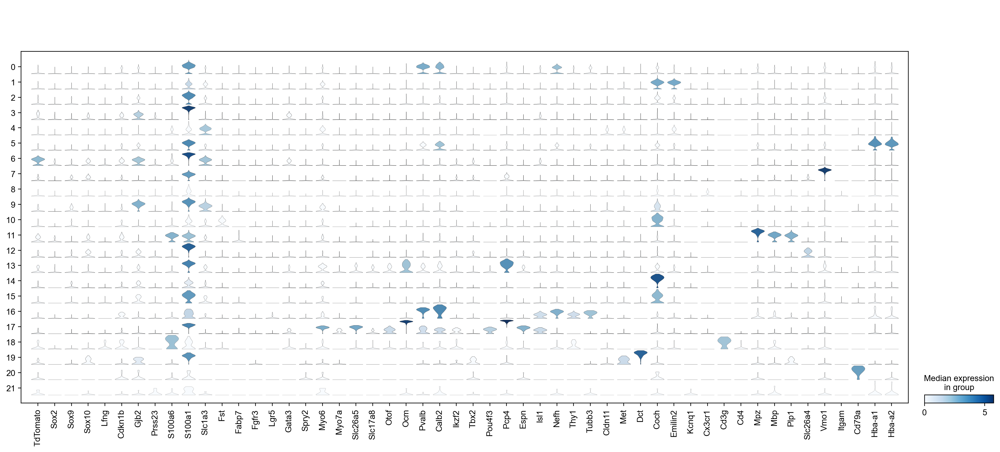

In [21]:
sc.pl.stacked_violin(adata, marker_genes, groupby='leiden', rotation=90);

In [30]:
#rename clusters
new_cluster_names = ['SGN1', 'TBC1', 'TBC2', 'SC1', 'Intermediate Cells', 'Hb+', 'SC2', 'RM',
                    'MP', 'Inner Sulcus', 'Spiral Ligament', 'Schwann', 'Spindle/Root Cells', 'HC_cHC1', 
                    'Fibrocytes', 'Fibrocytes 2', 'SGN2', 'HC_cHC2', 'T Cells', 'Intermediate Cell', 
                    'B Cells','Marginal Cells']
adata.rename_categories('leiden', new_cluster_names)

C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


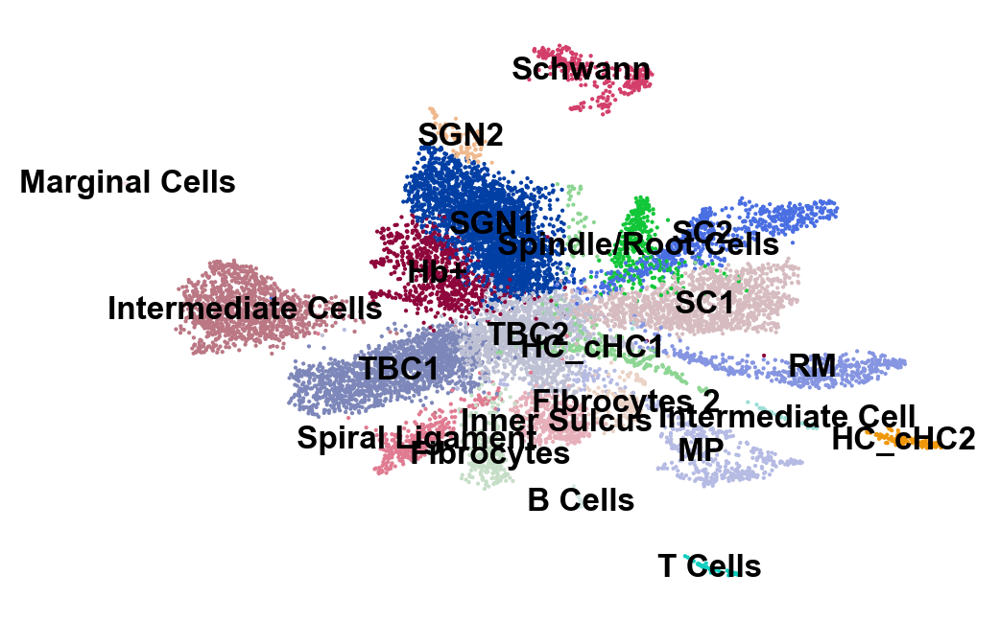

In [31]:
sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', frameon=False, save='.pdf')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


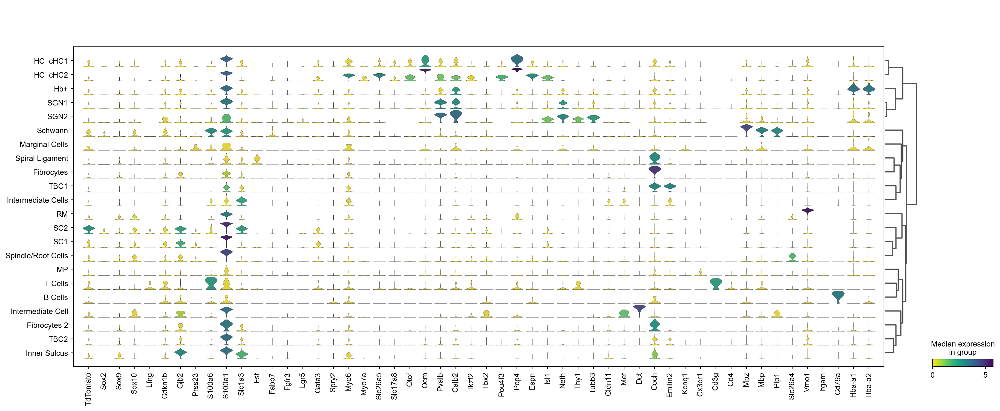

In [34]:
sc.tl.dendrogram(adata, groupby='leiden')
sc.pl.stacked_violin(adata, marker_genes, groupby='leiden', rotation=90, dendrogram=True,
                      cmap='viridis_r');

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


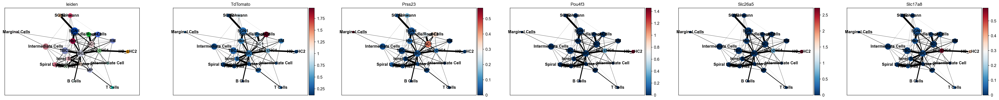

--> added 'pos', the PAGA positions (adata.uns['paga'])


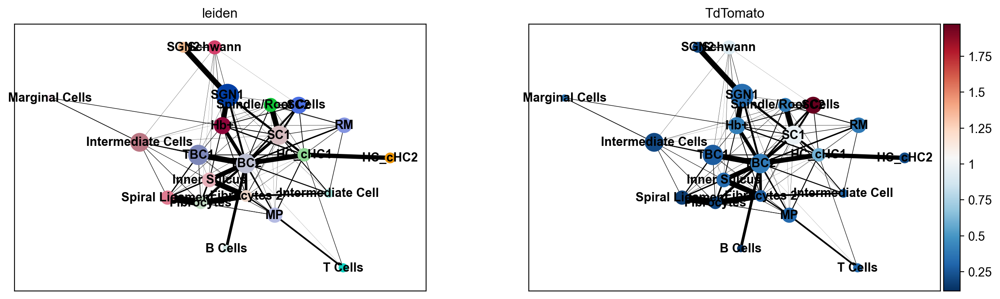

In [35]:
#PAGA
sc.tl.paga(adata, groups='leiden')
sc.pl.paga(adata, color=['leiden', 'TdTomato', 'Prss23', 'Pou4f3', 'Slc26a5', 'Slc17a8'])
sc.pl.paga(adata, color=['leiden', 'TdTomato'])

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


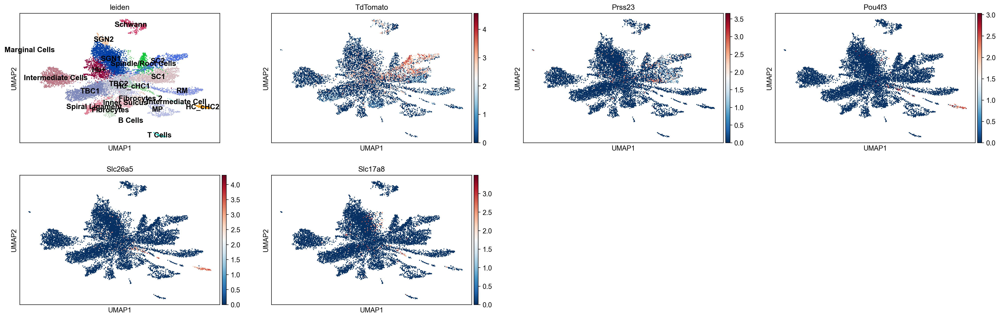

In [36]:
sc.tl.umap(adata, init_pos='paga')
sc.pl.umap(adata, color=['leiden', 'TdTomato', 'Prss23', 'Pou4f3', 'Slc26a5', 'Slc17a8'], 
          legend_loc='on data')

C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


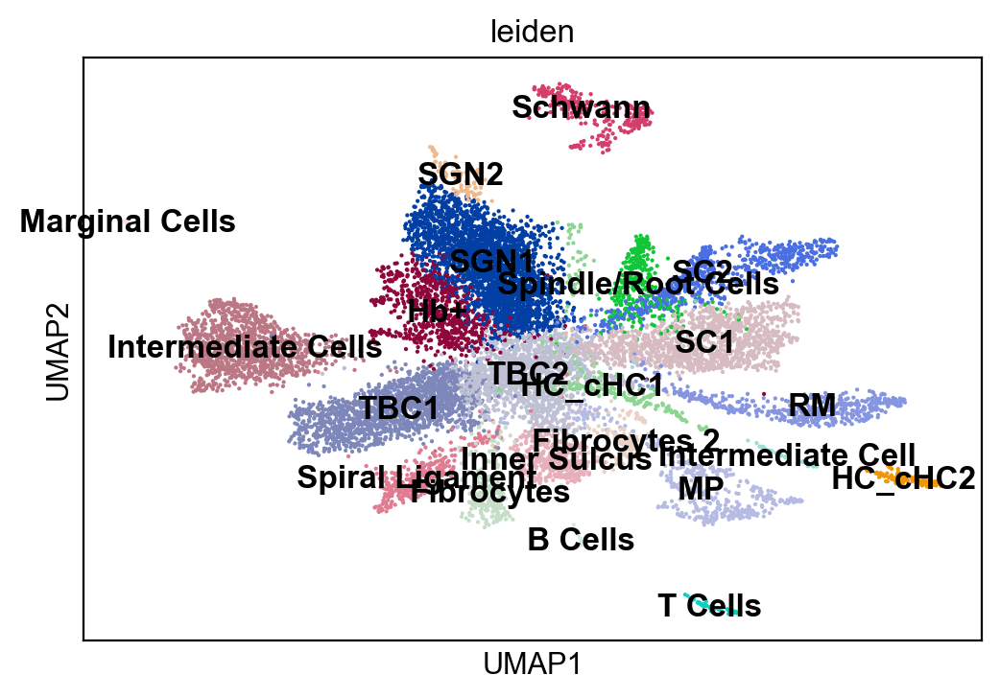

In [37]:
sc.pl.umap(adata, color='leiden', legend_loc='on data')

C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


--> added 'pos', the PAGA positions (adata.uns['paga'])


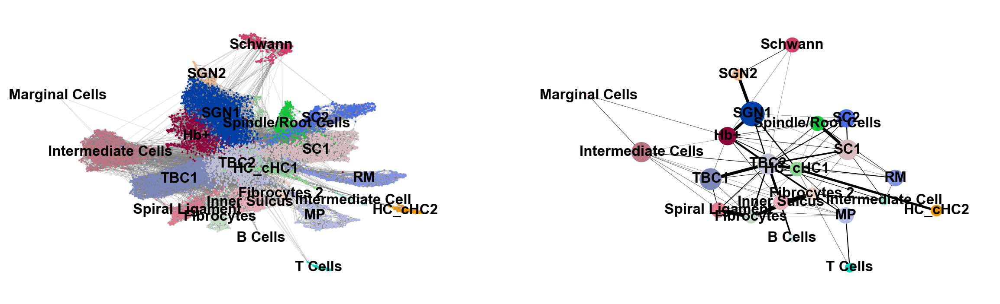

In [38]:
sc.pl.paga_compare(
    adata, threshold=0.03, title='', right_margin=0.2, size=10, edge_width_scale=0.5,
    legend_fontsize=12, fontsize=12, frameon=False, edges=True, save=True)

In [39]:
#subset SC, cHC, HC
adata_subset = adata[adata.obs['leiden'].isin(['HC_cHC1', 'HC_cHC2', 'SC1', 'SC2'])]

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


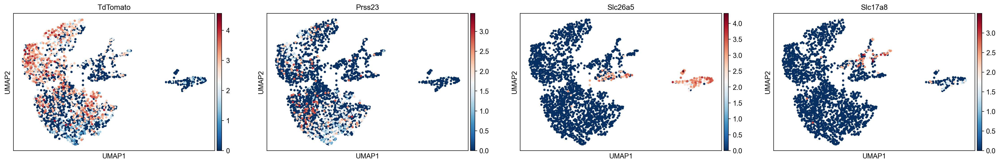

running Leiden clustering
    finished: found 6 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


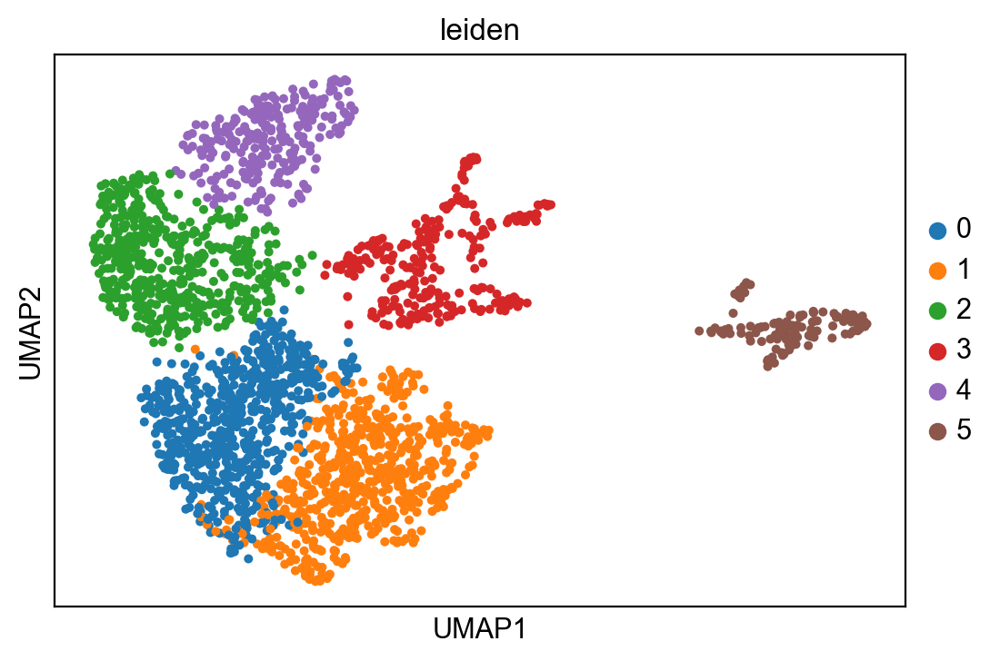

In [40]:
sc.pp.neighbors(adata_subset, n_neighbors=10, n_pcs=20)
sc.tl.pca(adata_subset, svd_solver='arpack')
sc.tl.umap(adata_subset) 
sc.pl.umap(adata_subset, color=['TdTomato', 'Prss23', 'Slc26a5', 'Slc17a8']) 
sc.tl.leiden(adata_subset, resolution = 0.3)
sc.pl.umap(adata_subset, color = 'leiden')

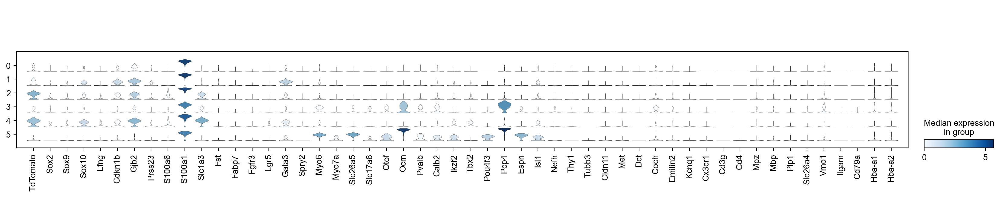

In [41]:
sc.pl.stacked_violin(adata_subset, marker_genes, groupby='leiden', rotation=90);

running Leiden clustering
    finished: found 11 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


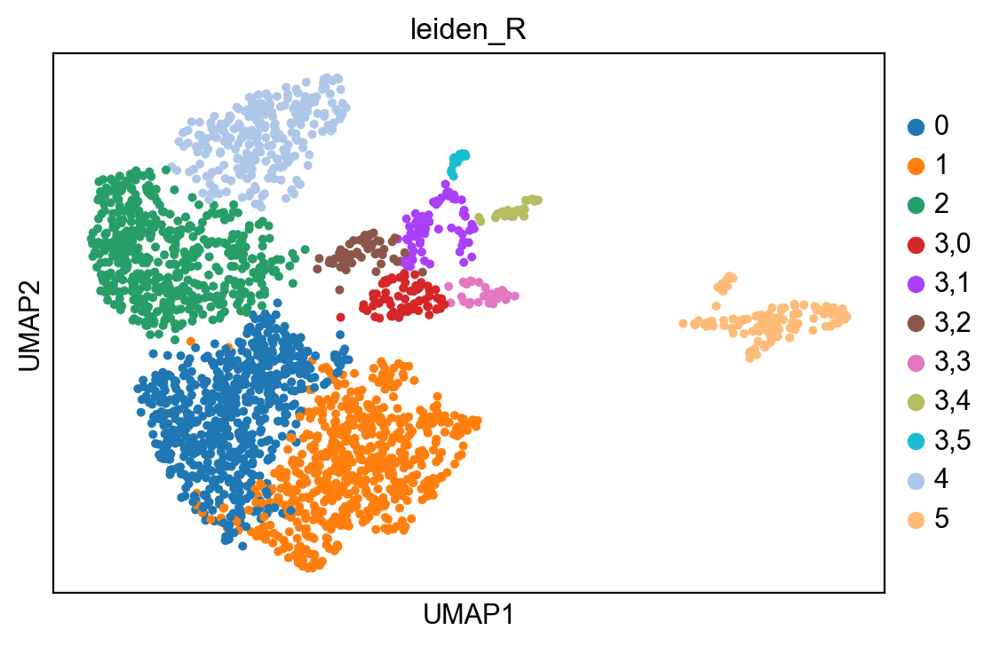

In [44]:
sc.tl.leiden(adata_subset, resolution = 0.3, restrict_to=('leiden', ['3']))
sc.pl.umap(adata_subset, color = 'leiden_R')

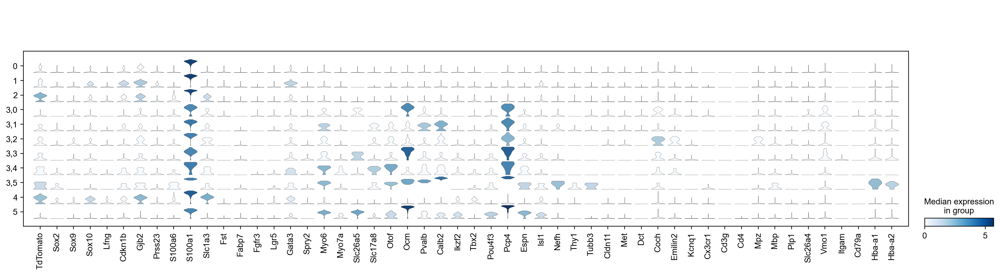

In [45]:
sc.pl.stacked_violin(adata_subset, marker_genes, groupby='leiden_R', rotation=90);

In [46]:
adata_subset.obs["leiden_R"].value_counts()

leiden_R
0      630
1      606
2      453
4      254
5      114
3,0     69
3,1     62
3,2     53
3,3     34
3,4     25
3,5     15
Name: count, dtype: int64

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_R']`


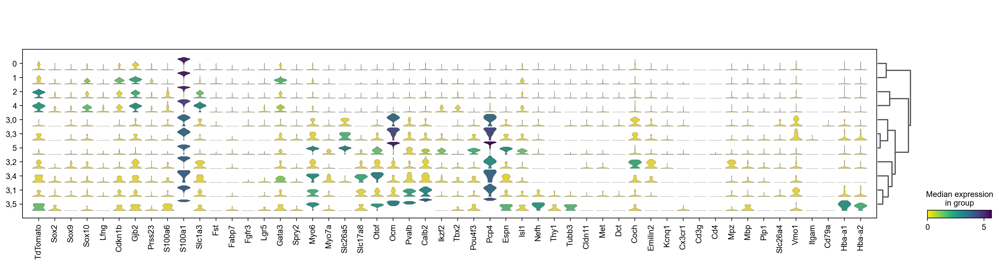

In [47]:
sc.tl.dendrogram(adata_subset, groupby='leiden_R')
sc.pl.stacked_violin(adata_subset, marker_genes, groupby='leiden_R', rotation=90, dendrogram=True,
                      cmap='viridis_r');

C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


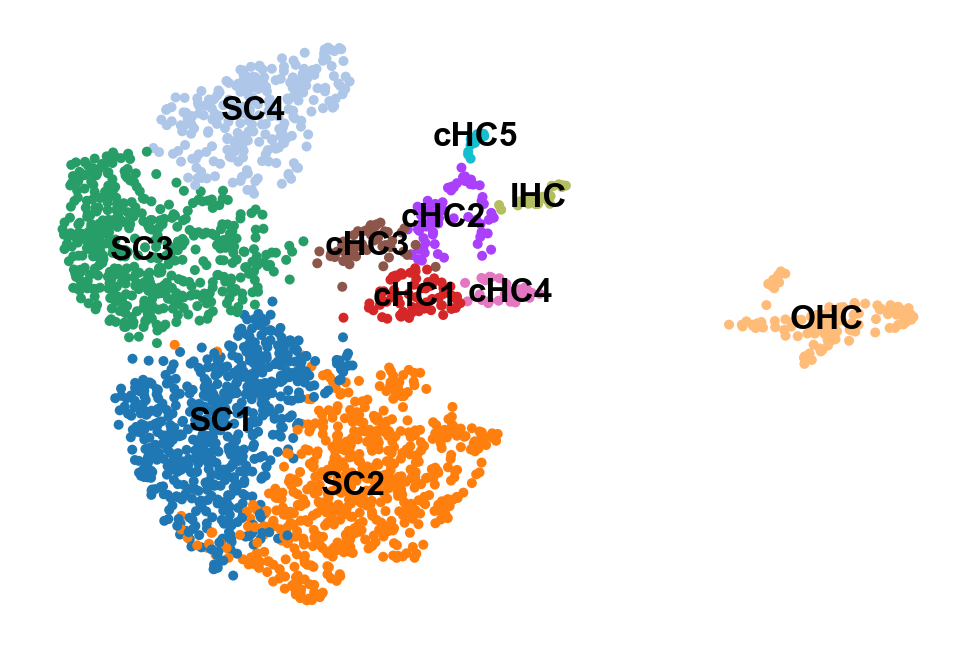

In [48]:
renamed_subclusters = ['SC1', 'SC2', 'SC3', 'cHC1', 'cHC2', 'cHC3', 'cHC4', 'IHC', 'cHC5', 'SC4',
                    'OHC']
adata_subset.rename_categories('leiden_R', renamed_subclusters)
sc.pl.umap(adata_subset, color='leiden_R', legend_loc='on data', title='', frameon=False, save='.pdf')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_R']`


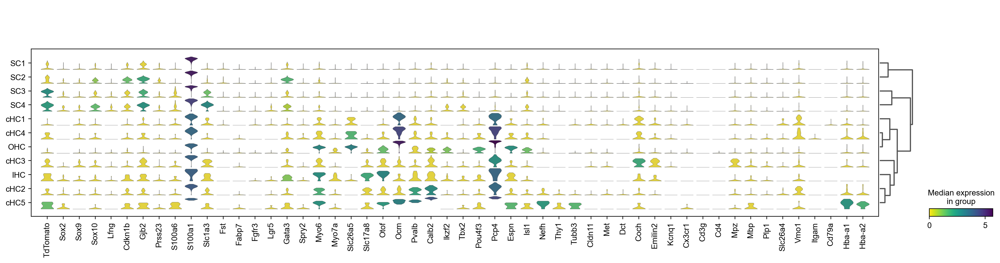

In [49]:
sc.tl.dendrogram(adata_subset, groupby='leiden_R')
sc.pl.stacked_violin(adata_subset, marker_genes, groupby='leiden_R', rotation=90, dendrogram=True,
                      cmap='viridis_r');

In [69]:
#subset results file
sub_results_file = 'C:/Users/rvi33352/Documents/Sox2TdT_C18A2CE/ScVelo/scanpy/Jupyter/SCHCcHC_subset.h5ad'  # the file that will store the analysis results
adata_subset.write(sub_results_file)

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


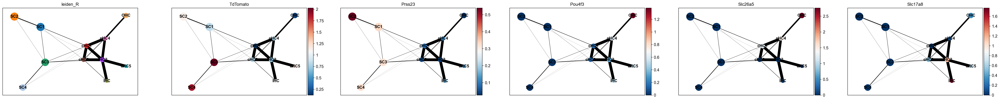

--> added 'pos', the PAGA positions (adata.uns['paga'])


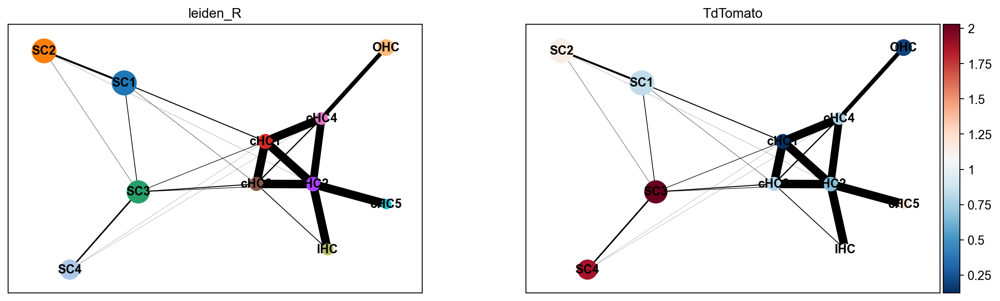

In [51]:
#PAGA
sc.tl.paga(adata_subset, groups='leiden_R')
sc.pl.paga(adata_subset, color=['leiden_R', 'TdTomato', 'Prss23', 'Pou4f3', 'Slc26a5', 'Slc17a8'])
sc.pl.paga(adata_subset, color=['leiden_R', 'TdTomato'])

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


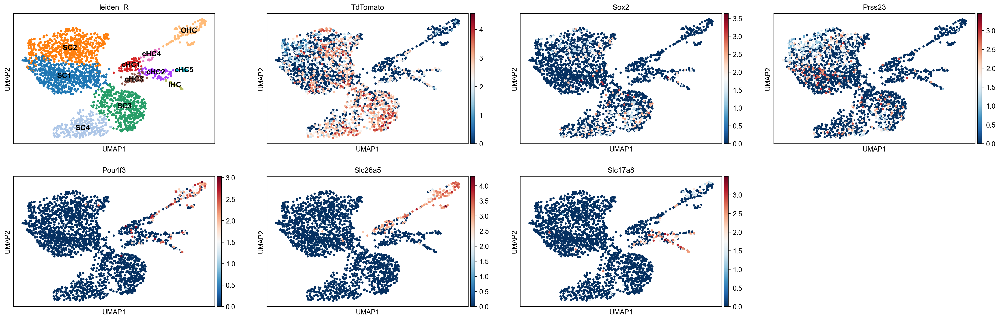

In [52]:
sc.tl.umap(adata_subset, init_pos='paga')
sc.pl.umap(adata_subset, color=['leiden_R', 'TdTomato', 'Sox2', 'Prss23', 'Pou4f3', 'Slc26a5', 'Slc17a8'], 
          legend_loc='on data')

--> added 'pos', the PAGA positions (adata.uns['paga'])


C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


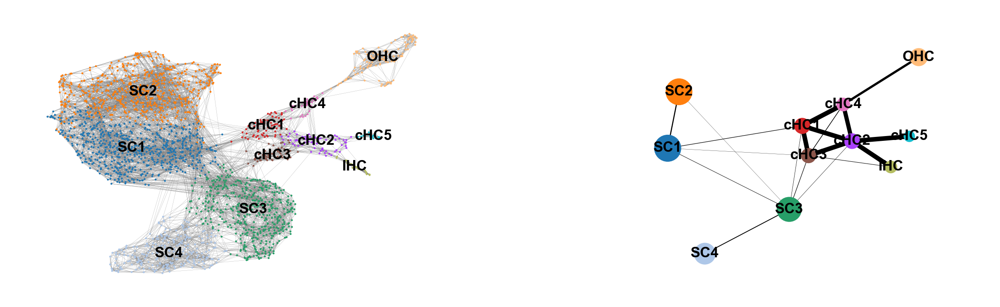

In [53]:
sc.pl.paga_compare(
    adata_subset, threshold=0.03, title='', right_margin=0.2, size=10, edge_width_scale=0.5,
    legend_fontsize=12, fontsize=12, frameon=False, edges=True, save=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


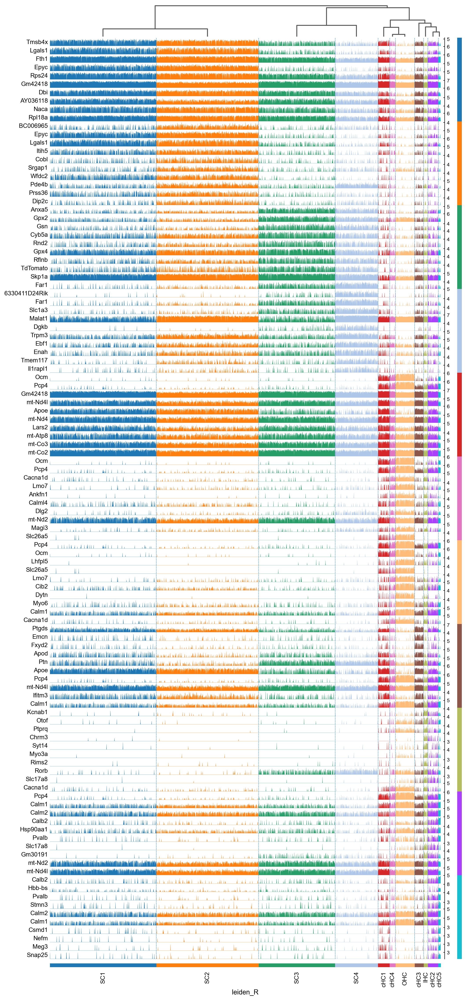

In [54]:
#Top 5 DEGS
sc.tl.rank_genes_groups(adata_subset, groupby='leiden_R', method='wilcoxon')
sc.pl.rank_genes_groups_tracksplot(adata_subset, n_genes=10, groupby = 'leiden_R', 
                                    values_to_plot='logfoldchanges', rotation = 90)

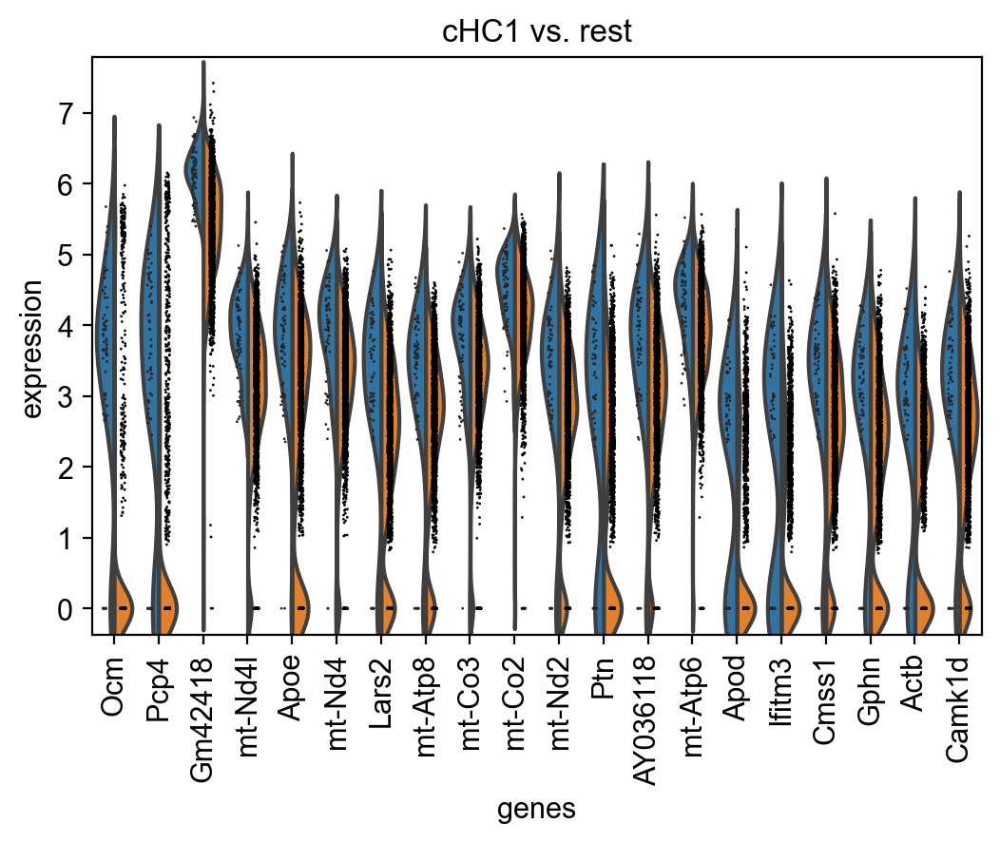

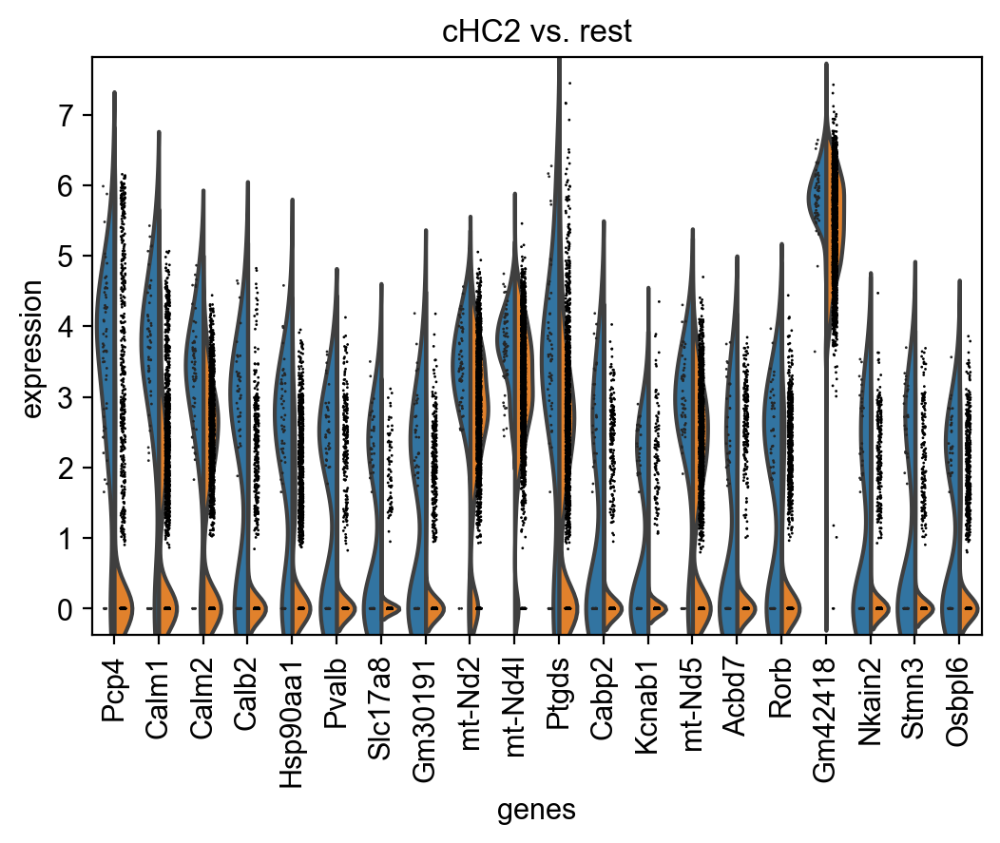

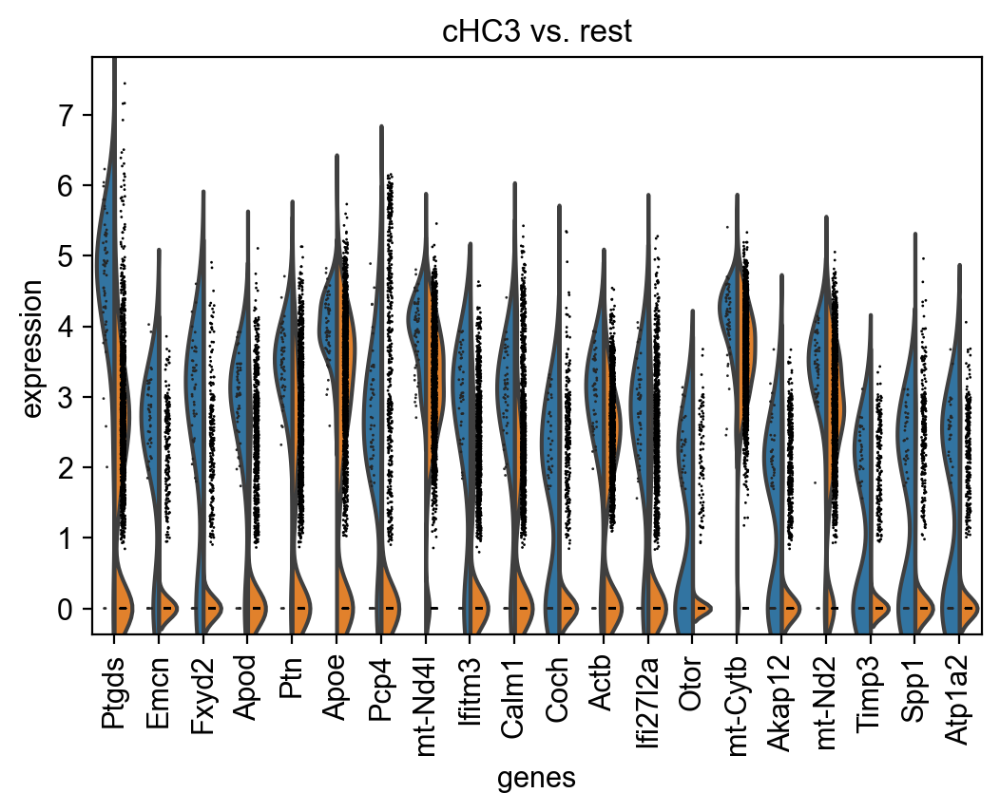

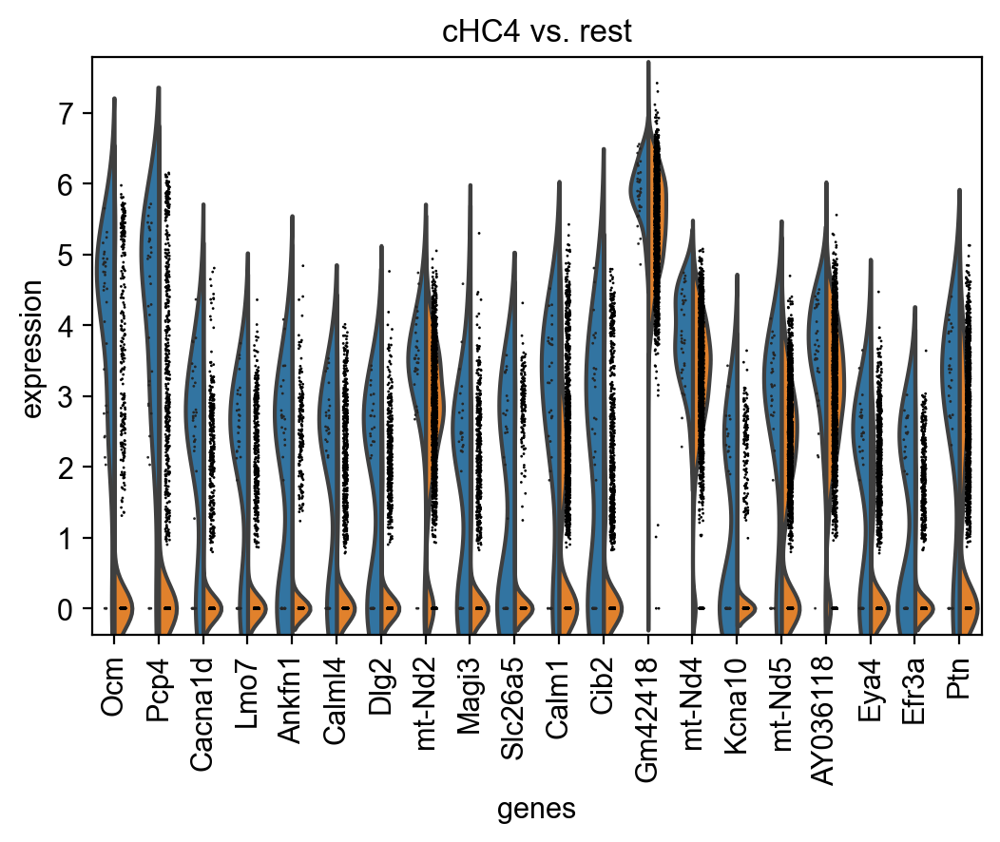

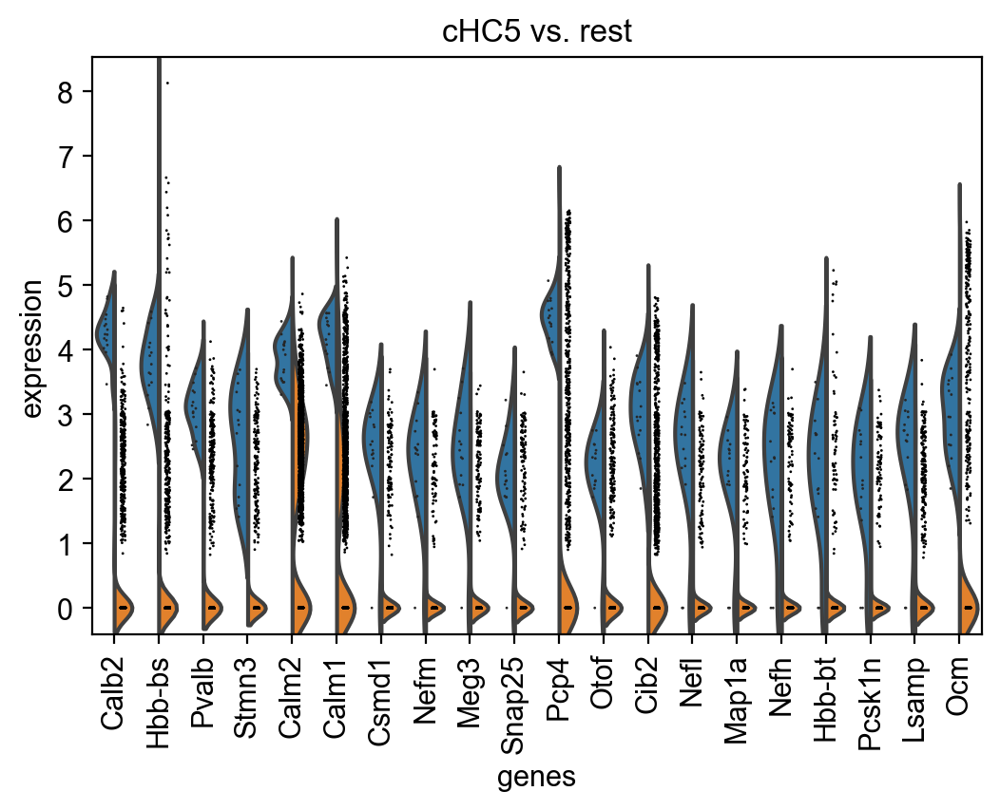

In [56]:
#cHC clusters top 20 DEGs
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC1'], n_genes=20)
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC2'], n_genes=20)
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC3'], n_genes=20)
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC4'], n_genes=20)
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC5'], n_genes=20)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


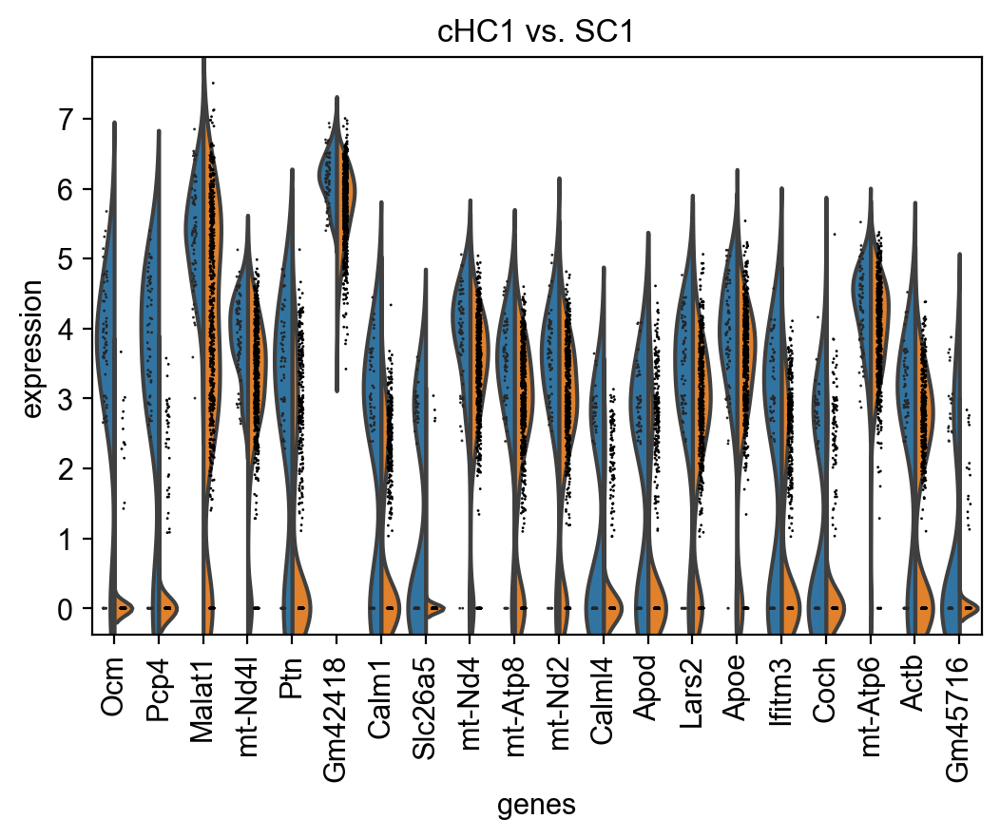

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


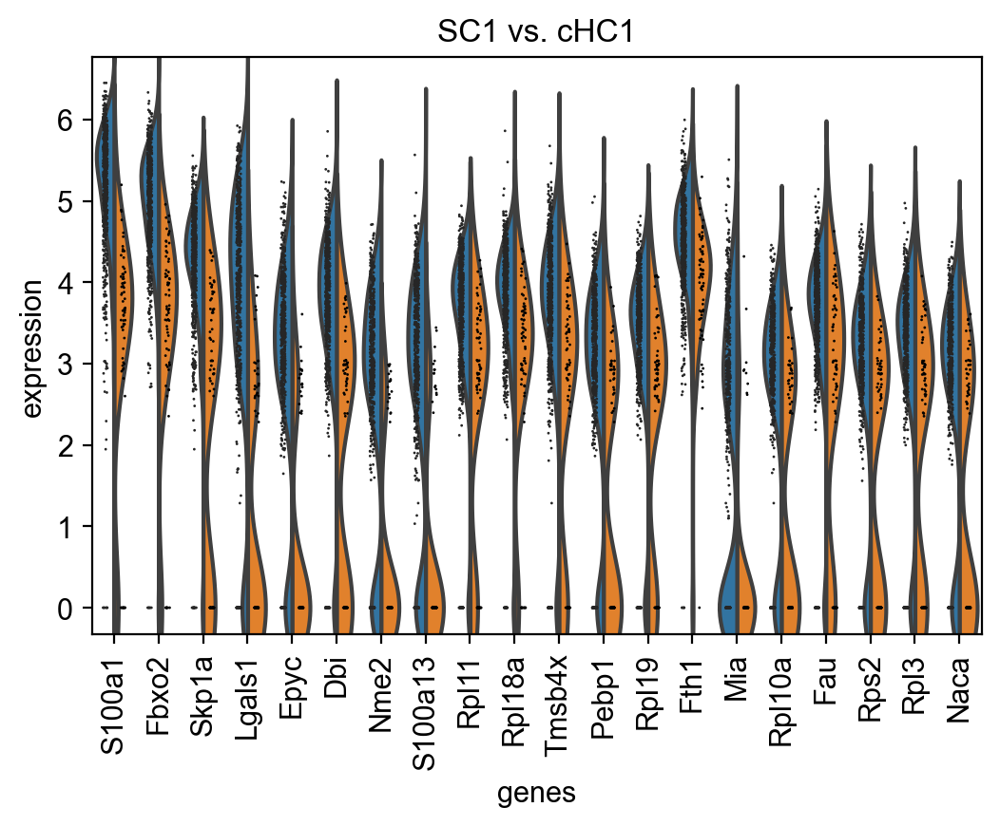

In [57]:
#cHC1 vs SC1 up- and down-regulated genes
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['cHC1'], reference='SC1', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC1'], n_genes=20)
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['SC1'], reference='cHC1', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['SC1'], n_genes=20)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


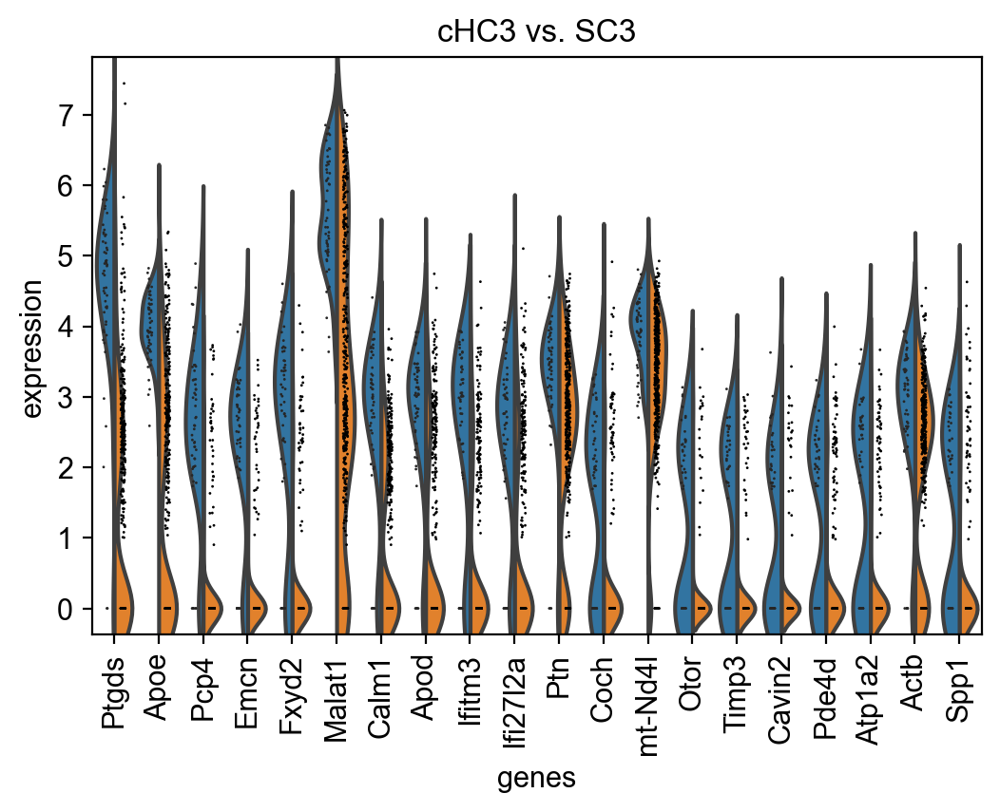

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


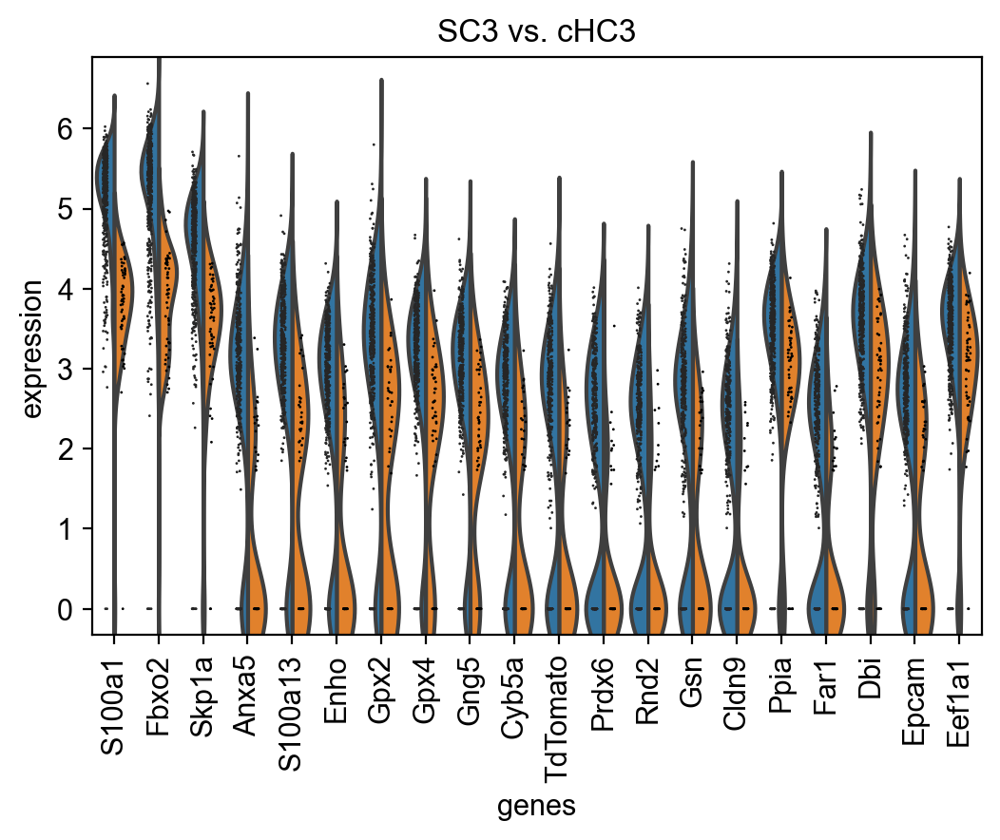

In [58]:
#cHC3 vs SC3 up- and down-regulated genes
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['cHC3'], reference='SC3', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC3'], n_genes=20)
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['SC3'], reference='cHC3', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['SC3'], n_genes=20)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


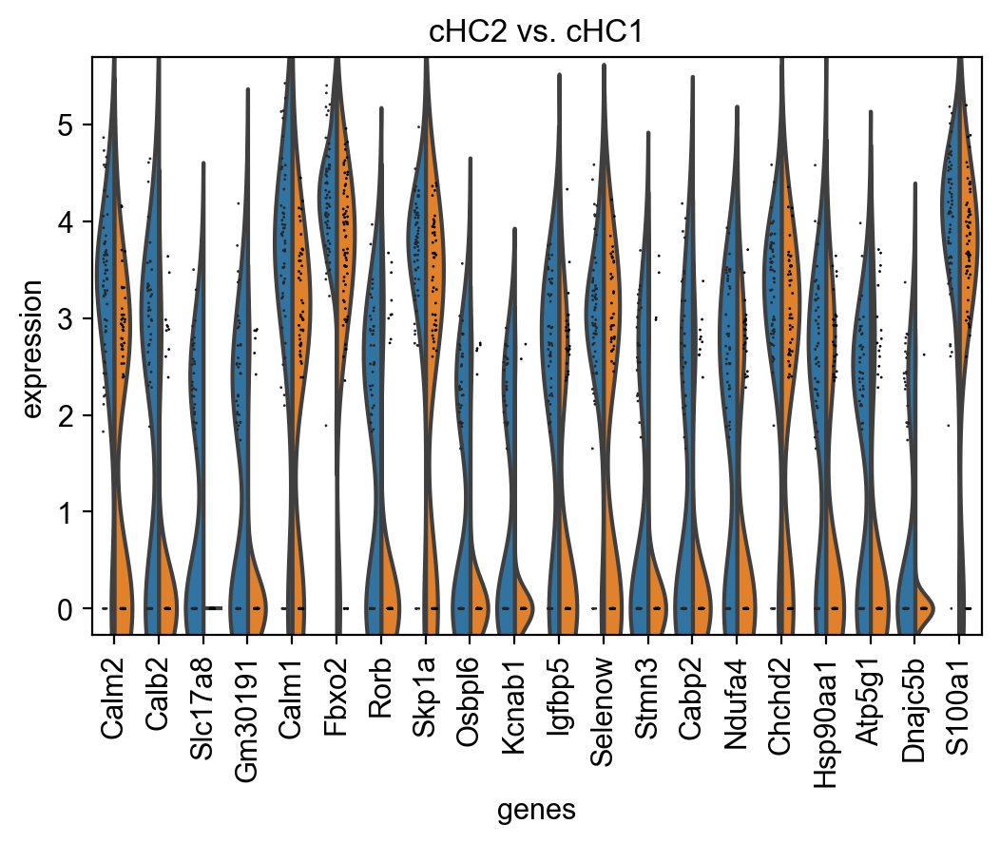

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


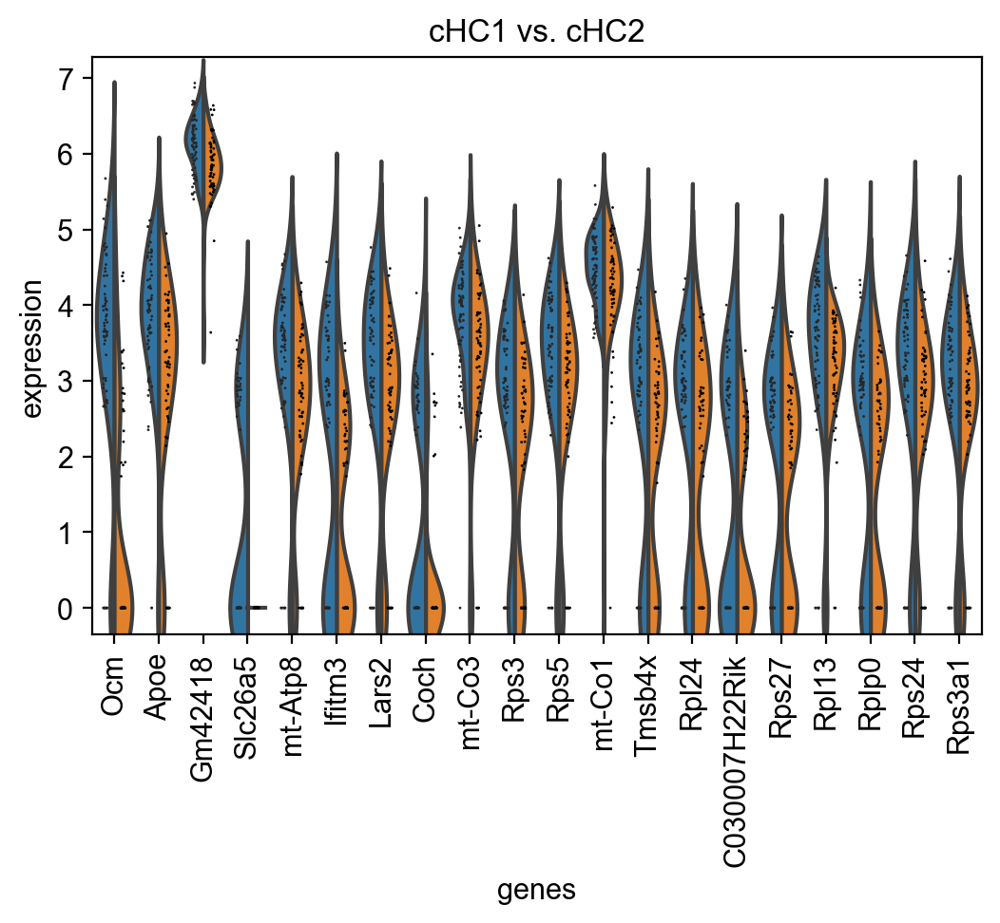

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


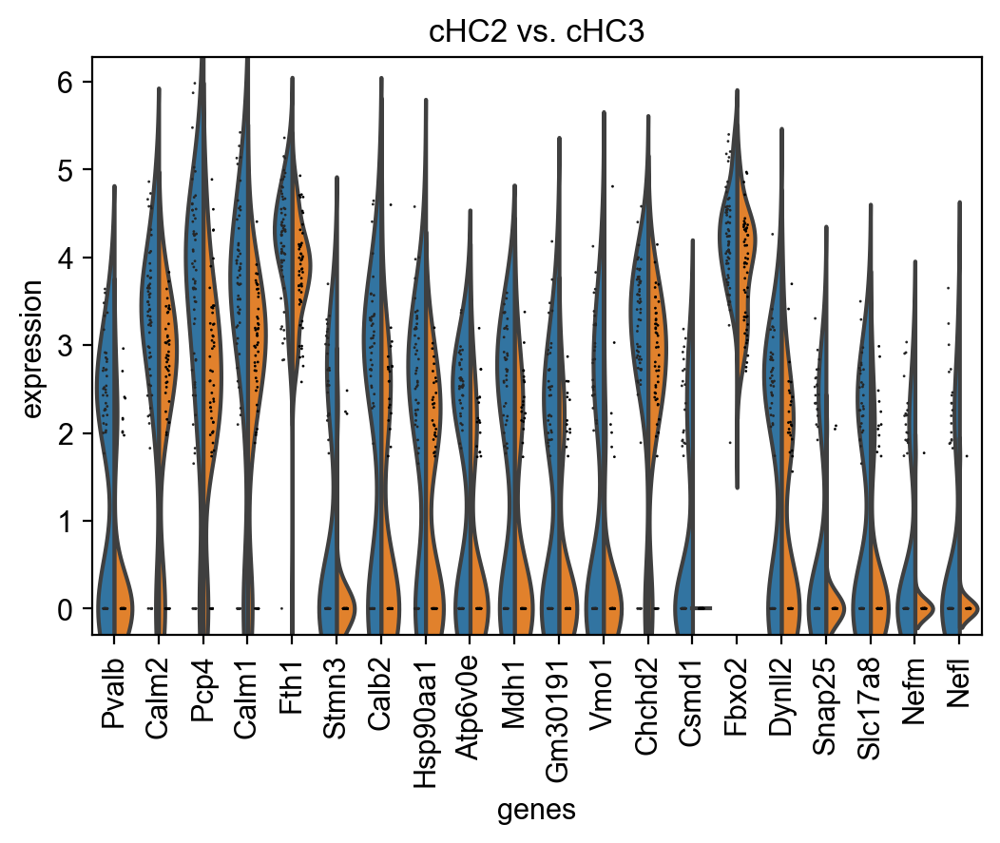

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


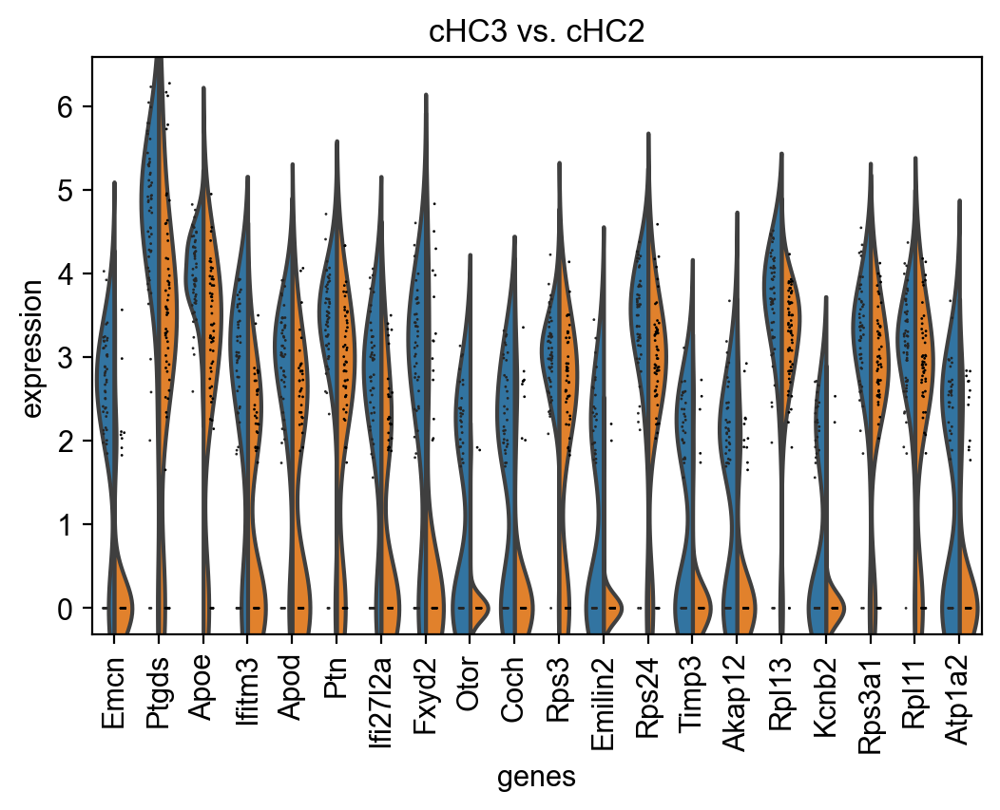

In [59]:
#cHC2 vs cHC1 and cHC3 up- and down-regulated genes
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['cHC2'], reference='cHC1', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC2'], n_genes=20)
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['cHC1'], reference='cHC2', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC1'], n_genes=20)
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['cHC2'], reference='cHC3', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC2'], n_genes=20)
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['cHC3'], reference='cHC2', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC3'], n_genes=20)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


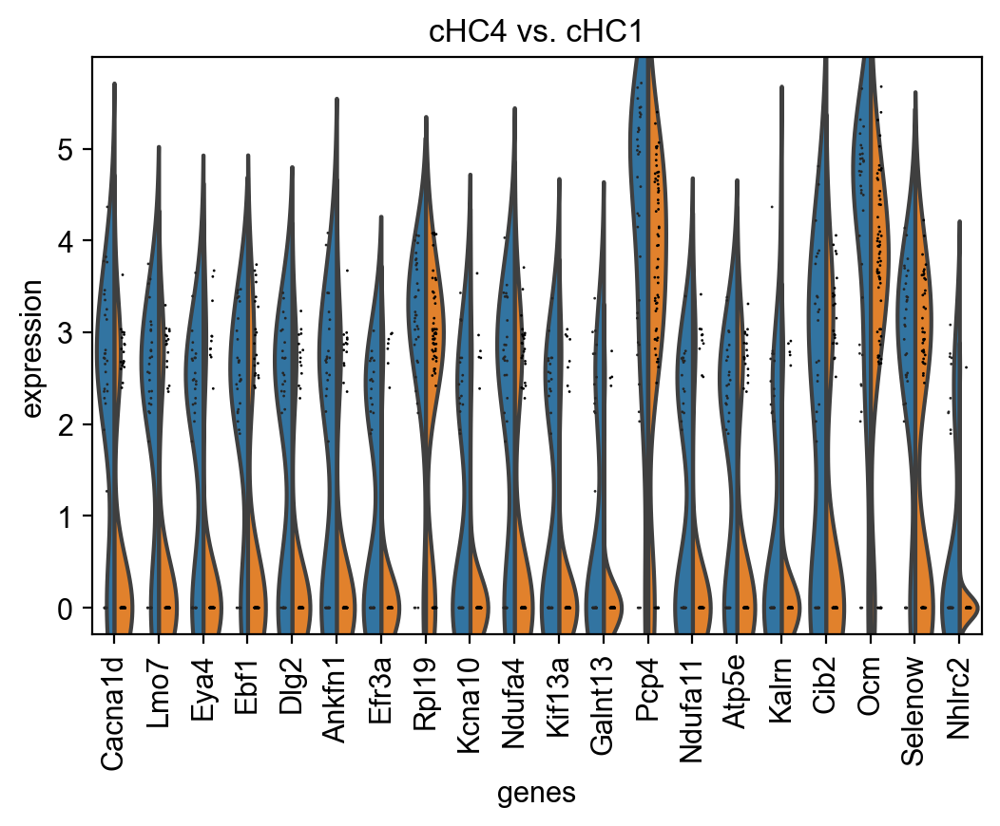

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


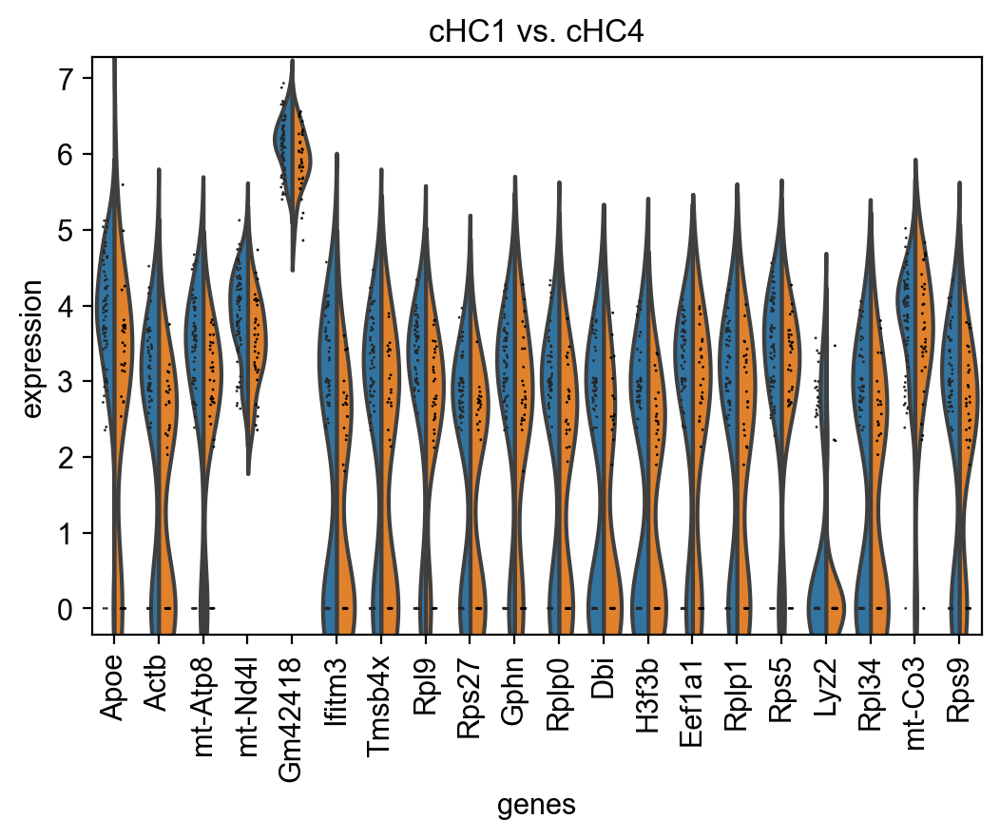

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


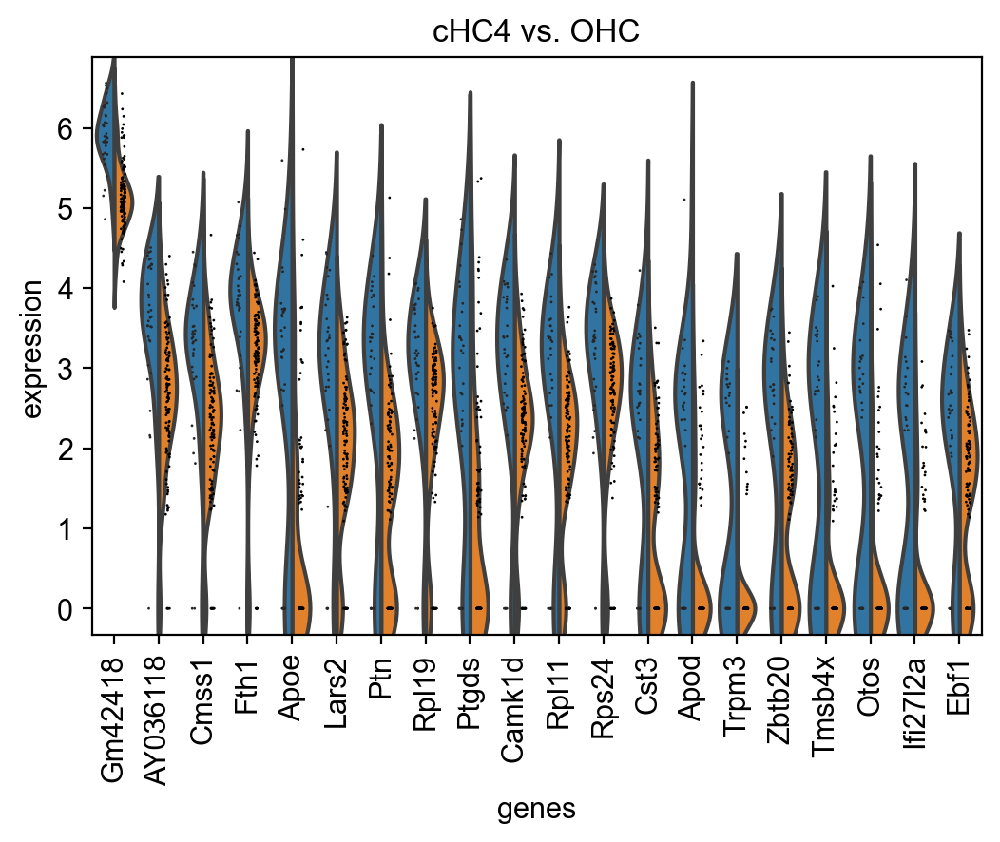

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


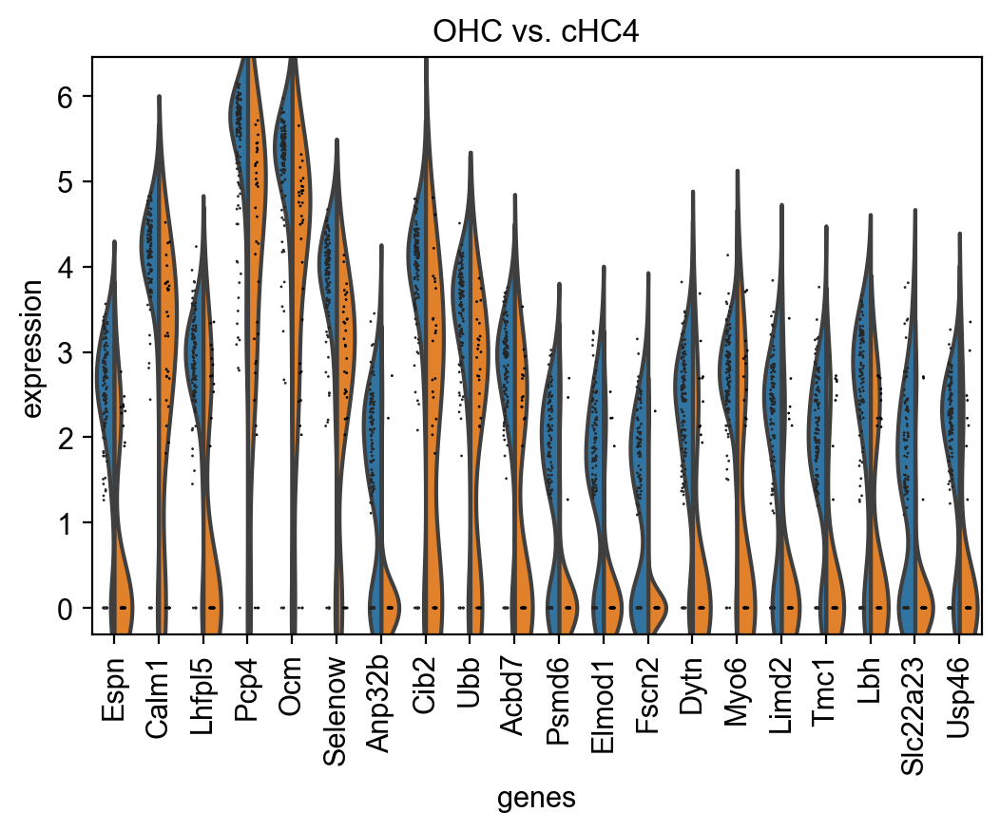

In [60]:
#cHC4 vs cHC1 and OHC up- and down-regulated genes
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['cHC4'], reference='cHC1', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC4'], n_genes=20)
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['cHC1'], reference='cHC4', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC1'], n_genes=20)
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['cHC4'], reference='OHC', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC4'], n_genes=20)
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['OHC'], reference='cHC4', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['OHC'], n_genes=20)

ranking genes
--> Few observations in a group for normal approximation (<=25). Lower test accuracy.
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


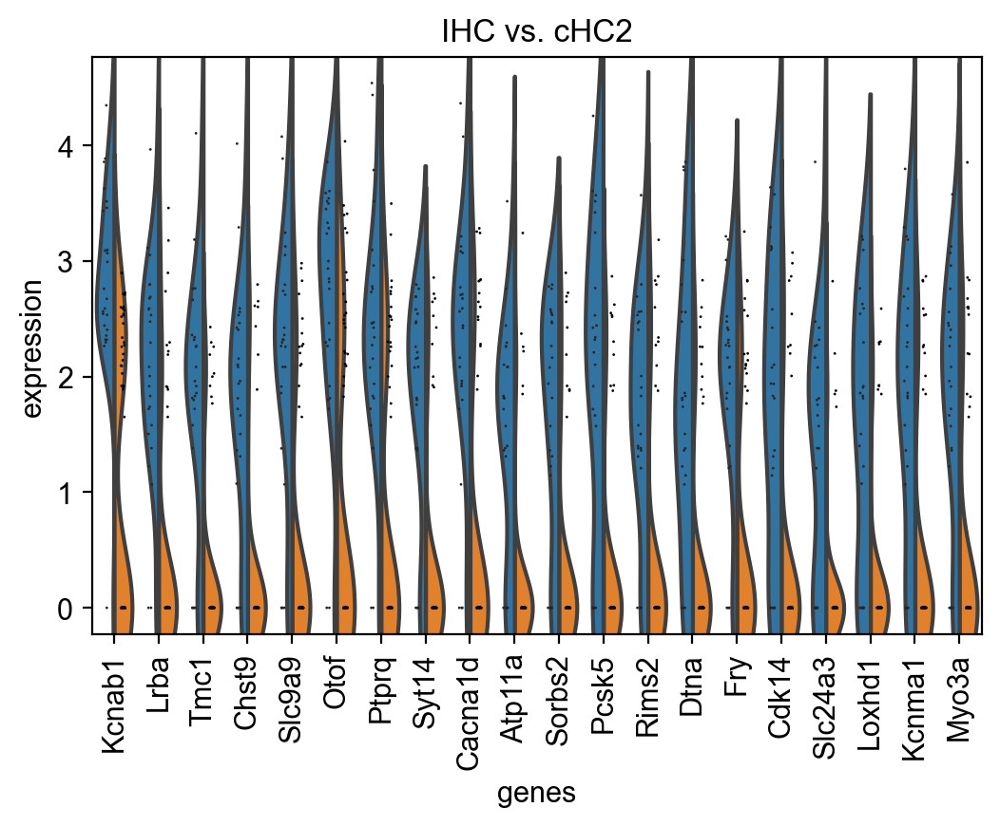

ranking genes
--> Few observations in a group for normal approximation (<=25). Lower test accuracy.
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


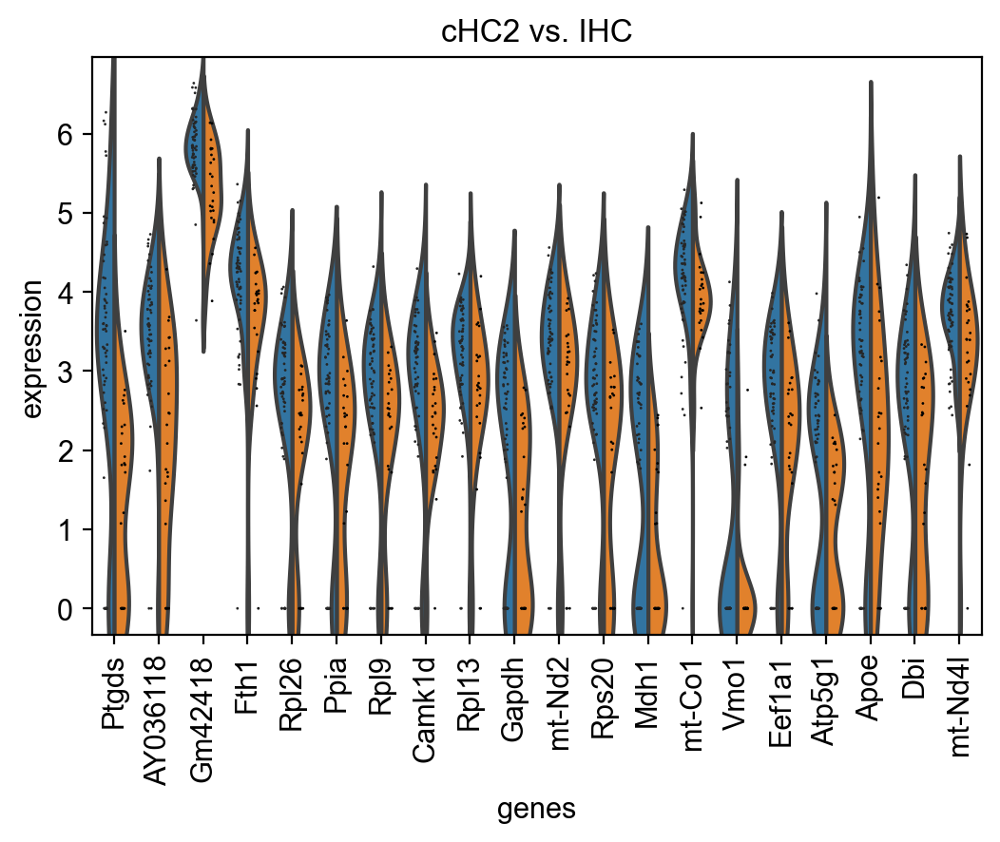

In [61]:
#IHC vs cHC2 up- and down-regulated genes
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['IHC'], reference='cHC2', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['IHC'], n_genes=20)
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['cHC2'], reference='IHC', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC2'], n_genes=20)

ranking genes
--> Few observations in a group for normal approximation (<=25). Lower test accuracy.
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


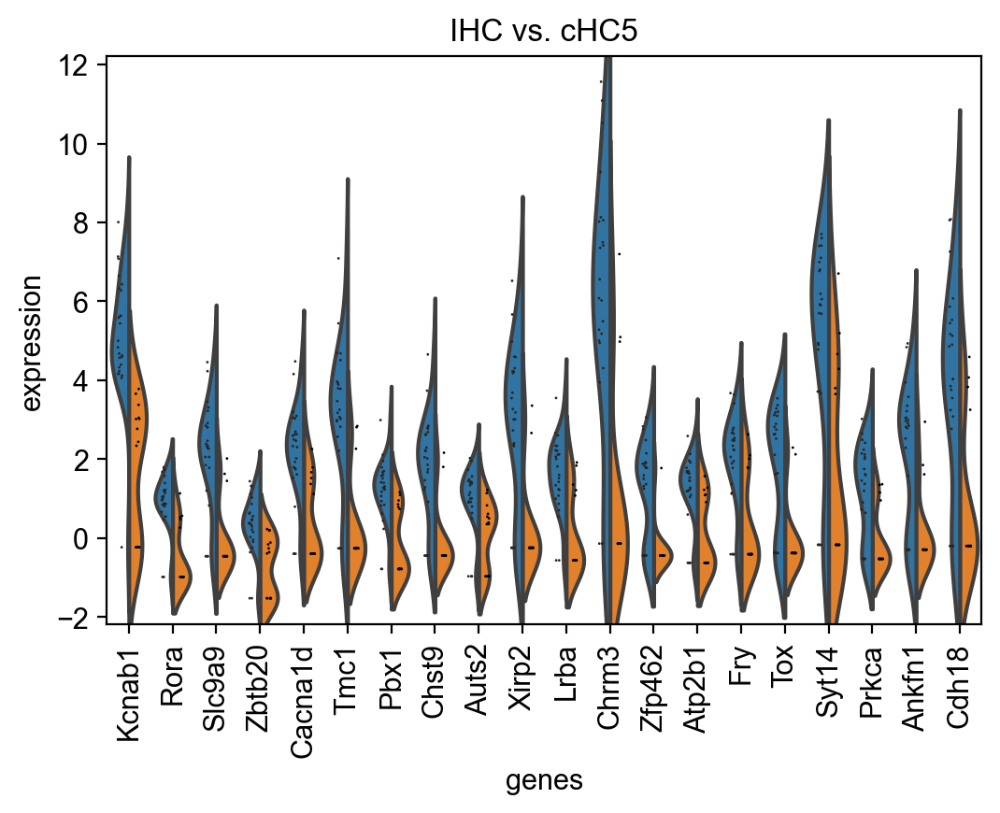

ranking genes
--> Few observations in a group for normal approximation (<=25). Lower test accuracy.
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


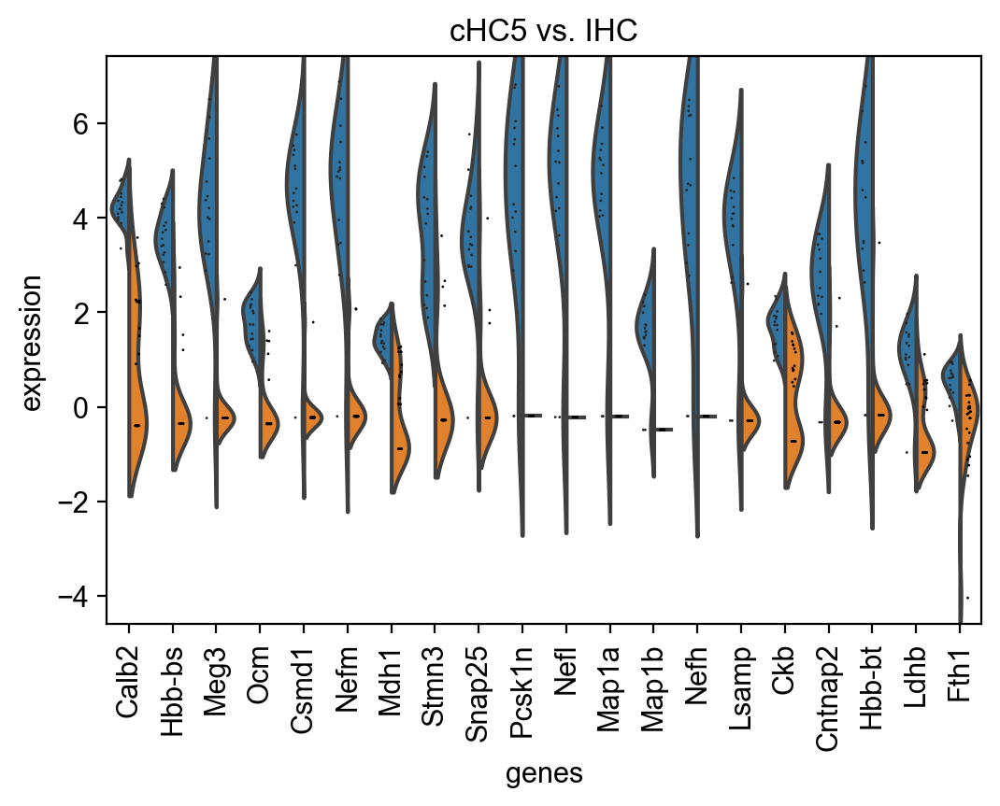

In [72]:
#compare end-state cHCs vs IHCs
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['IHC'], reference='cHC5', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['IHC'], n_genes=20)
sc.tl.rank_genes_groups(adata_subset, 'leiden_R', groups=['cHC5'], reference='IHC', method='wilcoxon')
sc.pl.rank_genes_groups_violin(adata_subset, groups=['cHC5'], n_genes=20)

In [62]:
#compute pseudotime; determine root cell
root_cell = int(np.where(adata_subset[:, 'TdTomato'].X == float(np.max(adata_subset[:, 'TdTomato'].X)))[0])
print(adata_subset.obs['leiden_R'][root_cell])

SC3


In [63]:
adata_subset.uns['iroot'] = root_cell

In [64]:
sc.tl.dpt(adata_subset)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.99790114 0.99087113 0.989503   0.979622   0.9776269
     0.9758348  0.964419   0.95940006 0.95105684 0.947112   0.94256425
     0.93889743 0.9290342  0.9236517 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)
computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


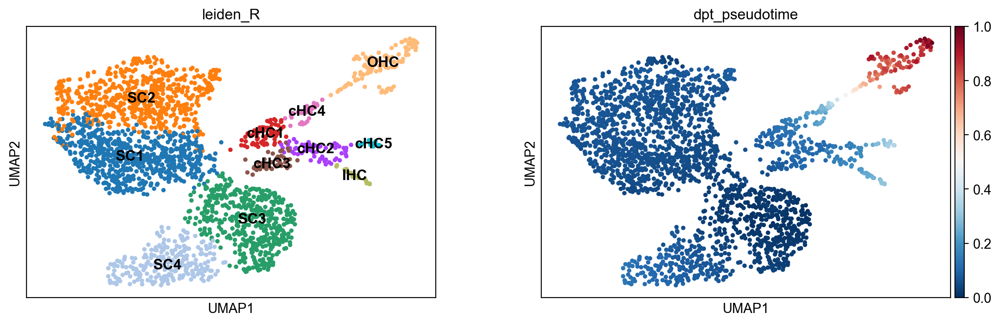

In [65]:
sc.pl.umap(adata_subset, color=['leiden_R', 'dpt_pseudotime'], legend_loc='on data')

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\paga.py:1229: UserWarning: FixedFormatter should only be used together with FixedLocator
  groups_axis.set_yticklabels(['', xlabel, ''], fontsize=ytick_fontsize)
C:\Users\rvi33352\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\paga.py:1276: UserWarning: FixedFormatter should only be used together with FixedLocator
  anno_axis.set_yticklabels(['', anno, ''], fontsize=ytick_fontsize)


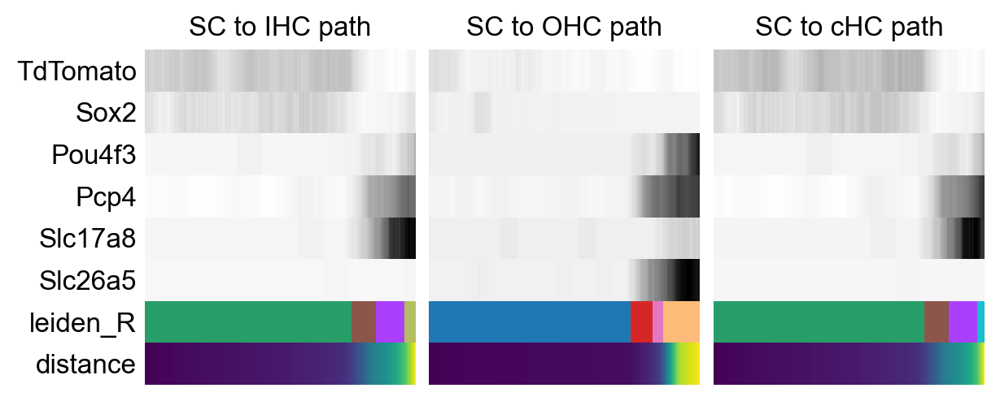

In [66]:
#set genes, paths, and compute gene expression over time
pt_genes=['TdTomato', 'Sox2', 'Pou4f3', 'Pcp4', 'Slc17a8', 'Slc26a5']
paths=[('SC to IHC', ['SC3', 'cHC3', 'cHC2', 'IHC']),
        ('SC to OHC', ['SC1', 'cHC1', 'cHC4', 'OHC']),
          ('SC to cHC', ['SC3', 'cHC3', 'cHC2', 'cHC5'])]
adata_subset.obs['distance'] = adata_subset.obs['dpt_pseudotime']
adata_subset.raw = sc.AnnData(sc.pp.scale(adata_subset.raw.X, copy=True),
                       var=adata_subset.raw.var)  
_, axs = pl.subplots(ncols=3, figsize=(6, 2.5), gridspec_kw={'wspace': 0.05, 'left': 0.12})
pl.subplots_adjust(left=0.05, right=0.98, top=0.82, bottom=0.2)
for ipath, (descr, path) in enumerate(paths):
    _, data = sc.pl.paga_path(
        adata_subset, path, pt_genes,                         
        show_node_names=False,
        ax=axs[ipath],
        ytick_fontsize=12,
        left_margin=0.15,
        n_avg=50,
        annotations=['distance'],
        show_yticks=True if ipath==0 else False,
        show_colorbar=False,
        color_map='Greys',
        color_maps_annotations={'distance': 'viridis'},
        title='{} path'.format(descr),
        return_data=True,
        show=False)
    data.to_csv('C:/Users/rvi33352/Documents/Conversion.csv'.format(descr))
pl.savefig('C:/Users/rvi33352/Documents/Conversion.pdf') 
pl.show()

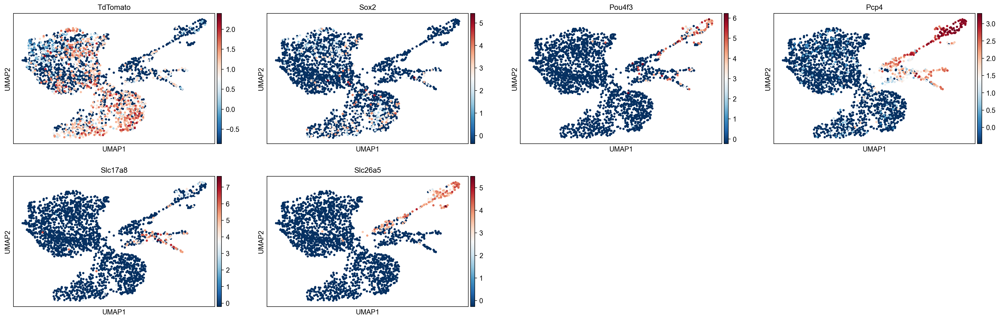

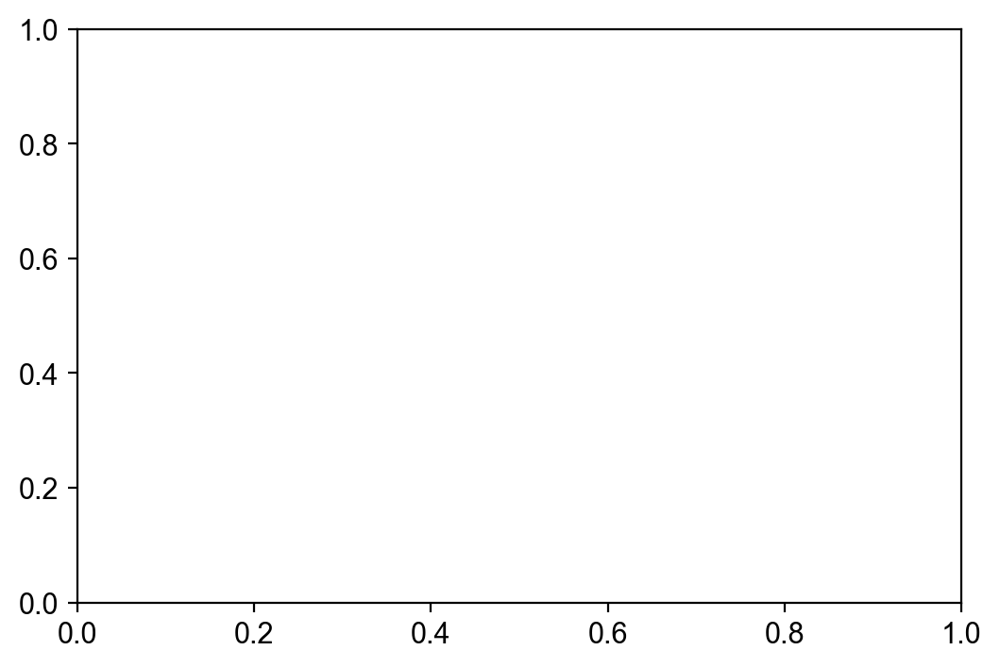

In [67]:
sc.pl.umap(adata_subset, color=pt_genes, legend_loc='on data')
_, axs = pl.subplots(ncols=1)

In [71]:
adata_subset

AnnData object with n_obs × n_vars = 2315 × 2353
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_R', 'dpt_pseudotime', 'distance'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'neighbors', 'pca', 'umap', 'leiden', 'leiden_colors', 'dendrogram_leiden', 'paga', 'leiden_sizes', 'leiden_R_colors', 'dendrogram_leiden_R', 'leiden_R_sizes', 'rank_genes_groups', 'iroot', 'diffmap_evals'
    obsm: 'X_pca', 'X_umap', 'X_diffmap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'